# Librerias

In [133]:
from itertools import product
from fractions import Fraction
from collections import defaultdict
import pandas as pd
import numpy as np # Importamos Numpy
import numpy.random as npr # para generar numeros aleatorios
import scipy.stats as sps # Importamos el modulo SciPy
from scipy.stats import randint # para trabajar una uniforme discreta en un rango de enteros
import matplotlib.pyplot as plt #Visualizar datos
import random # para generar numeros aleatorios
import sympy as sp
from IPython.display import Markdown
from scipy.stats import binom
from scipy.stats import uniform
import plotly.graph_objects as go # Para gráficos interactivos
from numpy import arctan
from math import pi

# Variables aleatorias

## 1 Variables aleatorias

Una variable aleatoria es una transformación X del espacio de resultados Ω al conjunto de números reales:
$$ X  : \Omega \rightarrow {R} $$

tal que para cualquier número real x,
$$ { ω \in \Omega : X (ω) \leq x } \in F $$

Se dice entonces que una variable aleatoria es una función determinista y no es variable ni aleatoria, sin embargo tales términos se justifican al considerar que los posibles resultados del experimento aleatorio
son los diferentes números reales x que la función X puede tomar. De manera informal, uno puede pensar también que una variable aleatoria es una pregunta o medición que se hace sobre cada uno delos resultados del 
experimento aleatorio y cuya respuesta es un número real, así cada resultado ω tiene asociado un único núumero x

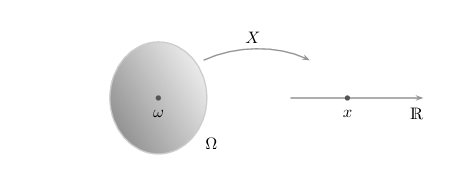

 Considere que el conjunto A es el intervalo infinito $(- \infty , x]$ para algún valor real x fijo. Entonces el evento $(X  \in (- \infty , x])$
 también puede escribirse de manera breve como $( X \leqslant x) $ y significa:
 $$ {ω \in \Omega : - \infty  < X (ω) \leqslant x } $$

### Ejemplos

El espacio muestral asociado a un experimento aleatorio

El espacio muestral $\Omega$ del experimento aleatorio de lanzar dos dados honestos, esta compuesto por todas las pearejas ordenadas $(i,j)$ tales que $1 \leq i,j \leq 6$

$$\Omega = \{ (i,j) \mid 1 \leq i,j \leq 6 \} $$
y sabemos que $\#\Omega = 6^2 = 36 $

In [3]:
Omega = set(product([1,2,3,4,5,6], repeat = 2))
Omega

{(1, 1),
 (1, 2),
 (1, 3),
 (1, 4),
 (1, 5),
 (1, 6),
 (2, 1),
 (2, 2),
 (2, 3),
 (2, 4),
 (2, 5),
 (2, 6),
 (3, 1),
 (3, 2),
 (3, 3),
 (3, 4),
 (3, 5),
 (3, 6),
 (4, 1),
 (4, 2),
 (4, 3),
 (4, 4),
 (4, 5),
 (4, 6),
 (5, 1),
 (5, 2),
 (5, 3),
 (5, 4),
 (5, 5),
 (5, 6),
 (6, 1),
 (6, 2),
 (6, 3),
 (6, 4),
 (6, 5),
 (6, 6)}

In [4]:
card_Omega = len(Omega)
card_Omega

36

Sea $S_n$ el evento "La suma de los dados en $n$". Esto es: 
$$S_n=\{(i,j)\in\Omega:i+j=n\}.$$

In [6]:
def S(n):
    Sn = {(i,j) for i in range(1,7) for j in range(1,7) if i+j==n}
    return Sn

In [7]:
print(S(9))

{(6, 3), (4, 5), (5, 4), (3, 6)}


In [8]:
print(S(12))

{(6, 6)}


2. La variable aleatoria asociada a $S_n$

In [10]:
# Definir la funcion P(A)
# Es la probabilidad del evento A definida mediante la definición clásica

def P(A):
    P = Fraction(len(A), len(Omega))
    return P

In [11]:
# Vamos a definir un diccionario S
# (i,j) pares ordenados y los valores de su suma

S = {(i,j) : i+j for i,j in Omega} 

In [13]:
# Agrupación de combinaciones por suma
dS = defaultdict(set)

In [14]:
# Vamos a recorrer sobre los elementos en S

for i,j in S.items():
    
    dS[j].add(i)

In [15]:
list(dS.items()) 

[(7, {(1, 6), (2, 5), (3, 4), (4, 3), (5, 2), (6, 1)}),
 (4, {(1, 3), (2, 2), (3, 1)}),
 (9, {(3, 6), (4, 5), (5, 4), (6, 3)}),
 (10, {(4, 6), (5, 5), (6, 4)}),
 (6, {(1, 5), (2, 4), (3, 3), (4, 2), (5, 1)}),
 (8, {(2, 6), (3, 5), (4, 4), (5, 3), (6, 2)}),
 (11, {(5, 6), (6, 5)}),
 (3, {(1, 2), (2, 1)}),
 (5, {(1, 4), (2, 3), (3, 2), (4, 1)}),
 (2, {(1, 1)}),
 (12, {(6, 6)})]

In [16]:
# LeyS almacenar la probabilidad de casa posible suma,
# Usando la función P(A)
# En otras palabras "la función de densidad"
# A es el conjunto de pares que producden la suma i

leyS = {i : P(A) for i, A in dS.items() }
leyS

{7: Fraction(1, 6),
 4: Fraction(1, 12),
 9: Fraction(1, 9),
 10: Fraction(1, 12),
 6: Fraction(5, 36),
 8: Fraction(5, 36),
 11: Fraction(1, 18),
 3: Fraction(1, 18),
 5: Fraction(1, 9),
 2: Fraction(1, 36),
 12: Fraction(1, 36)}

Recordemos que una variable aleatoria real $X$, es una función
$$X : \Omega \to \mathbb{R}$$

Sabemos que la función de densidad de una v.a. discreta $X$, se define como sigue:
$$ f_X(x) = \begin{cases} \mathbb{P}(X=x), \quad \text{si } x\in R_{X} \\ 0, \quad \text{e.o.c} \end{cases} $$
donde $R_X$ es el rango de la v.a. $X$.

Para nuestro evento $S_n$, se tiene la siguiente variable aleatoria
$$ S : \Omega \to \{2,3,4,5,6,7,8,9,10,11,12\}$$

In [19]:
# Vamos a crear una serie 

ley_S = pd.Series(leyS)
ley_S.sort_index() #ordenar

2     1/36
3     1/18
4     1/12
5      1/9
6     5/36
7      1/6
8     5/36
9      1/9
10    1/12
11    1/18
12    1/36
dtype: object

In [21]:
# LeyS(i) devuelve la probabilidad de obtener la suma i, si está en el rango de posibles sumas

def leyS(i):
    if i in range(2,13):
        x = ley_S[i]
    else:
        x = 0 # si no está en el rango me devuelve cero
    return x

In [22]:
# Vamos a crear el rango de S

#creo una lista con los posibles valores
rango_S = [k for k in range(2,13)]

#Obtenemos la probabilidad de cada suma 
p_k = [float(leyS(k)) for k in rango_S]

In [23]:
# Creamos un DataFrame con:
# - los valores del rango_S
# - las probabilidades p_k
# Indexamos una etiqueta S_2,...,S_12

# zip() -> toma dos listas y las combina en pares ordenados
lS = pd.DataFrame(list(zip(rango_S, p_k)), index=[f"S_{i}" for i in range(2,13)], columns = ['rango','densidad'])
lS

,rango,densidad
S_2,2,0.027778
S_3,3,0.055556
S_4,4,0.083333
S_5,5,0.111111
S_6,6,0.138889
S_7,7,0.166667
S_8,8,0.138889
S_9,9,0.111111
S_10,10,0.083333
S_11,11,0.055556


<Axes: xlabel='rango'>

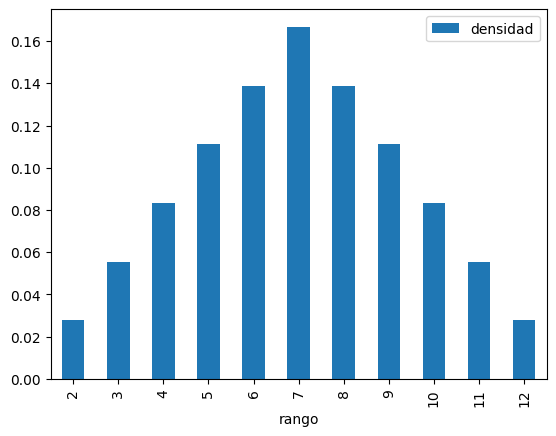

In [24]:
lS.plot.bar( x= 'rango', y = 'densidad')

### Ejercicios

1.- Define $\Omega$

In [25]:
Omega = set(product(range(1,11), repeat = 2))
Omega

{(1, 1),
 (1, 2),
 (1, 3),
 (1, 4),
 (1, 5),
 (1, 6),
 (1, 7),
 (1, 8),
 (1, 9),
 (1, 10),
 (2, 1),
 (2, 2),
 (2, 3),
 (2, 4),
 (2, 5),
 (2, 6),
 (2, 7),
 (2, 8),
 (2, 9),
 (2, 10),
 (3, 1),
 (3, 2),
 (3, 3),
 (3, 4),
 (3, 5),
 (3, 6),
 (3, 7),
 (3, 8),
 (3, 9),
 (3, 10),
 (4, 1),
 (4, 2),
 (4, 3),
 (4, 4),
 (4, 5),
 (4, 6),
 (4, 7),
 (4, 8),
 (4, 9),
 (4, 10),
 (5, 1),
 (5, 2),
 (5, 3),
 (5, 4),
 (5, 5),
 (5, 6),
 (5, 7),
 (5, 8),
 (5, 9),
 (5, 10),
 (6, 1),
 (6, 2),
 (6, 3),
 (6, 4),
 (6, 5),
 (6, 6),
 (6, 7),
 (6, 8),
 (6, 9),
 (6, 10),
 (7, 1),
 (7, 2),
 (7, 3),
 (7, 4),
 (7, 5),
 (7, 6),
 (7, 7),
 (7, 8),
 (7, 9),
 (7, 10),
 (8, 1),
 (8, 2),
 (8, 3),
 (8, 4),
 (8, 5),
 (8, 6),
 (8, 7),
 (8, 8),
 (8, 9),
 (8, 10),
 (9, 1),
 (9, 2),
 (9, 3),
 (9, 4),
 (9, 5),
 (9, 6),
 (9, 7),
 (9, 8),
 (9, 9),
 (9, 10),
 (10, 1),
 (10, 2),
 (10, 3),
 (10, 4),
 (10, 5),
 (10, 6),
 (10, 7),
 (10, 8),
 (10, 9),
 (10, 10)}

In [26]:
card_omega = len(Omega)
card_omega

100

2.- Calcula las probabilidades asociadas

In [27]:
def S(n):
    Sn = {(i,j) for i in range(1,11) for j in range(1,11) if abs(i-j)==n}
    return Sn

In [28]:
print(S(7))

{(8, 1), (1, 8), (9, 2), (3, 10), (2, 9), (10, 3)}


In [29]:
def P(A):
    P = Fraction(len(A), len(Omega))
    return P

In [30]:
S = {(i,j) : abs(i-j) for i,j in Omega}

In [31]:
ds = defaultdict(set)

In [32]:
for i,j in S.items():
    ds[j].add(i)

In [33]:
list(ds.items())

[(5,
  {(1, 6),
   (2, 7),
   (3, 8),
   (4, 9),
   (5, 10),
   (6, 1),
   (7, 2),
   (8, 3),
   (9, 4),
   (10, 5)}),
 (4,
  {(1, 5),
   (2, 6),
   (3, 7),
   (4, 8),
   (5, 1),
   (5, 9),
   (6, 2),
   (6, 10),
   (7, 3),
   (8, 4),
   (9, 5),
   (10, 6)}),
 (1,
  {(1, 2),
   (2, 1),
   (2, 3),
   (3, 2),
   (3, 4),
   (4, 3),
   (4, 5),
   (5, 4),
   (5, 6),
   (6, 5),
   (6, 7),
   (7, 6),
   (7, 8),
   (8, 7),
   (8, 9),
   (9, 8),
   (9, 10),
   (10, 9)}),
 (0,
  {(1, 1),
   (2, 2),
   (3, 3),
   (4, 4),
   (5, 5),
   (6, 6),
   (7, 7),
   (8, 8),
   (9, 9),
   (10, 10)}),
 (6, {(1, 7), (2, 8), (3, 9), (4, 10), (7, 1), (8, 2), (9, 3), (10, 4)}),
 (3,
  {(1, 4),
   (2, 5),
   (3, 6),
   (4, 1),
   (4, 7),
   (5, 2),
   (5, 8),
   (6, 3),
   (6, 9),
   (7, 4),
   (7, 10),
   (8, 5),
   (9, 6),
   (10, 7)}),
 (2,
  {(1, 3),
   (2, 4),
   (3, 1),
   (3, 5),
   (4, 2),
   (4, 6),
   (5, 3),
   (5, 7),
   (6, 4),
   (6, 8),
   (7, 5),
   (7, 9),
   (8, 6),
   (8, 10),
   (9, 7),
   (10

 3.-Define la función de densidad

In [34]:
leyS = {i : P(A) for i, A in ds.items()}
leyS

{5: Fraction(1, 10),
 4: Fraction(3, 25),
 1: Fraction(9, 50),
 0: Fraction(1, 10),
 6: Fraction(2, 25),
 3: Fraction(7, 50),
 2: Fraction(4, 25),
 8: Fraction(1, 25),
 7: Fraction(3, 50),
 9: Fraction(1, 50)}

In [35]:
ley_S = pd.Series(leyS)
ley_S.sort_index() 

0    1/10
1    9/50
2    4/25
3    7/50
4    3/25
5    1/10
6    2/25
7    3/50
8    1/25
9    1/50
dtype: object

4.- Verifica que:

$$\sum_{k\in R_{X}}\mathbb{P}(X=k) = 1$$

In [36]:
def leyS(i):
    if i in range(10):
        x = ley_S[i]
    else:
        x = 0 # si no esta en el rango me devuelve 0
    return x

In [37]:
rango_S = [k for k in range(10)]

In [38]:
p_k = [float(leyS(k)) for k in rango_S]

In [39]:
lS = pd.DataFrame(list(zip(rango_S, p_k)), index=[f"S_{i}" for i in range(10)], columns = ['rango','densidad'])
lS

,rango,densidad
S_0,0,0.10
S_1,1,0.18
S_2,2,0.16
S_3,3,0.14
S_4,4,0.12
S_5,5,0.10
S_6,6,0.08
S_7,7,0.06
S_8,8,0.04
S_9,9,0.02


In [40]:
lS['acum'] = lS['densidad'].cumsum()
lS


,rango,densidad,acum
S_0,0,0.10,0.10
S_1,1,0.18,0.28
S_2,2,0.16,0.44
S_3,3,0.14,0.58
S_4,4,0.12,0.70
S_5,5,0.10,0.80
S_6,6,0.08,0.88
S_7,7,0.06,0.94
S_8,8,0.04,0.98
S_9,9,0.02,1.00


5.- Gráfica la función de densidad

<Axes: xlabel='rango'>

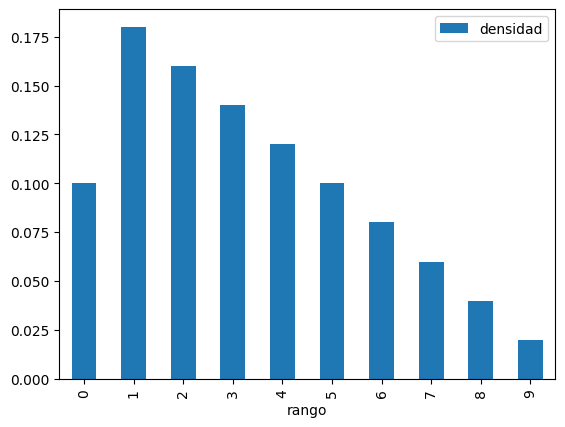

In [41]:
lS.plot.bar (x = 'rango', y = 'densidad')

Además, calcula la probabilidad de que los números de las dos bolas seleccionadas difieran por $2$ o más.

In [42]:
p2 = [leyS(i) for i in range(2,10)]
sum(p2)

Fraction(18, 25)

## 1.1 Discretas

#### 1.1.1 Variable aleatoria uniforme discreta

Una variable aleatoria $X$ tiene distribución uniforme discreta en el conjunto $\{x_1,...,x_n\}$ si su función de densidad está dada por
$$ f_X(x) = \mathbb{P}(X=x) = \begin{cases} \frac{1}{n}, \quad \text{si } x\in \{x_1,...,x_n\} \\
0, \quad \text{e.o.c} \end{cases}$$

Se llama uniforme porque cada uno de sus posibles resultados de $X$ tienene la misma probabilidad.

**Notación:** $X\sim Unif(x_1,...,x_n)$

La esperanza y varianza de $X$, están dadas por:

$$ \mathbb{E}[X] = \frac{x_n + x_1}{2} $$
y
$$ \text{Var}(X)  = \frac{(x_n - x_1 + 1)^2 -1}{12}$$

Una variable aleatoria es discreta cuando el conjunto de valores que ésta toma es un conjunto discreto, es decir, un conjunto finito o numerable

Decimos que una variable aleatoria X tiene una distribución uniforme discreta sobre el conjunto de n números { x1,....xn } la probabilidad de que X tome cualquiera de 
estos valores es constante 1/n .Esta distribución surge en espacios de probabilidad equiprobables,esto es,en situaciones en donde tenemos n resultados diferentes y todos ellos 
tienen la misma probabilidad de ocurrir.

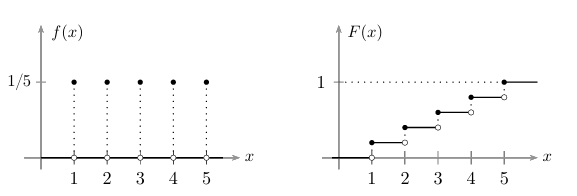

### Ejemplo

 Un experimento aleatorio consiste en escoger a una person ω al azar dentro de una población humana dada. La variable aleatoria X evaluada en ω corresponde a conocer una de las 
características que aparecen en la lista de abajo acerca de la persona escogida. Debido a limitaciones en nuestras mediciones de estas características, en cada caso puede considerarse
 que la variable X es discreta.
 a) Edad en años.
 b) Número de hijos.
 c) Peso.
 d) Estatura

La función de distribución de una v.a. uniforme es:
$$ F_X(x) = \mathbb{P}(X\le x) = \begin{cases} 0, \quad \text{si } x < x_1 \\ \frac{x}{n}, \quad \text{si } x\in \{x_1,...,x_n\} \\
1, \quad \text{si } x > x_n \end{cases}$$

**Ejemplo** Se lleva a cabo una rifa donde los boletos están enumerados del $00$ al $99$. Si $Y$ es la variable aleatoria definida como el número del boleto ganador, entonces:  
$$\mathbb{P}(Y=k)=\begin{cases}
	\frac{1}{100} &\quad \text{si } k=00,01,\dots,99 \\
	0 &\quad \text{en otro caso}
\end{cases}$$
Consideremos que el premio de la rifa se determina a partir del número premiado de la siguiente forma: $X=Y+1$, donde $X$ es el monto del premio en pesos y $Y$ es el número premiado, entonces $X$ es una variable aleatoria, pues es una función de $Y$, y además se tiene
	$$f_{X}(k)=\begin{cases}
		\frac{1}{100} &\quad \text{si } x=1,2,\dots,100 \\
		0 &\quad \text{en otro caso}
	\end{cases}$$

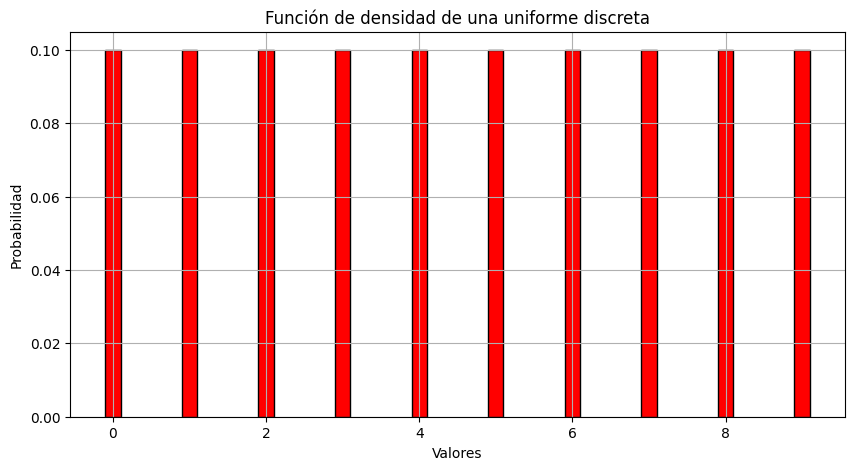

In [5]:
# Definir el rango de la distribución uniforme discreta [low, high)
low = 0 #límite inferior
high = 10 #límite superior

#Crear los valores posibles dentro del rango
x = np.arange(low, high)

#Calcular la función de masa de probabilidad
pmf = np.full_like(x, 1/ (high-low) , dtype = float )

#Para crear una figura más grande
plt.figure(figsize=(10, 5))

#Graficar pmf
plt.bar(x, pmf, width=0.2, color='r', edgecolor='black')
plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title('Función de densidad de una uniforme discreta')
plt.grid(True)
plt.show() #mostrar el gráfica

### Ejercicios

$\color{red}{\text{Ejercicio 1.}}$ Verifica que, en efecto, la esperanza y varianza de una variable aleatoria uniforme.

In [12]:
def printmd(text):
    display(Markdown(text))

In [27]:
printmd(' #### Demostración de la esperanza de una distribución uniforme')

x, X = sp.symbols('x X', integer=True)
f = sp.Function('f_X')(x)

x1, xn, n = sp.symbols('x1 x_n n', integer=True)
# nx = xn - x1 + 1

printmd('Función de densidad:')
fX_x = sp.Eq(
    f,
    sp.Piecewise(
        (1 / n, (x >= x1) & (x <= xn)), 
        (0, True)
    )
)
display(fX_x)

fx = 1 / n

printmd('Esperanza de la función:')
E = sp.Function('E')
var_E_X = sp.summation(x * fx, (x, x1, xn))
sym_E_X = sp.Sum(x * fx, (x, x1, xn))
Eq_E_X = sp.Eq(
    E(X), 
    sym_E_X
)
display(Eq_E_X)

Eq_E_X = sp.Eq(
    E(X),
    var_E_X
)
display(Eq_E_X)

var_E_X = sp.simplify(var_E_X)
Eq_E_X = sp.Eq(
    E(X),
    var_E_X
)
display(Eq_E_X)

var_E_X = sp.factor(var_E_X, deep=True)
Eq_E_X = sp.Eq(
    E(X),
    var_E_X
)
display(Eq_E_X)

printmd('Usando $n = x_n - x_1 + 1$')
var_E_X = sp.factor(var_E_X.subs(xn - x1 + 1, n))
Eq_E_X = sp.Eq(
    E(X),
    var_E_X
)
display(Eq_E_X)

 #### Demostración de la esperanza de una distribución uniforme

Función de densidad:

Eq(f_X(x), Piecewise((1/n, (x >= x1) & (x <= x_n)), (0, True)))

Esperanza de la función:

Eq(E(X), Sum(x/n, (x, x1, x_n)))

Eq(E(X), (-x1**2/2 + x1/2 + x_n**2/2 + x_n/2)/n)

Eq(E(X), (-x1**2 + x1 + x_n**2 + x_n)/(2*n))

Eq(E(X), -(x1 + x_n)*(x1 - x_n - 1)/(2*n))

Usando $n = x_n - x_1 + 1$

Eq(E(X), (x1 + x_n)/2)

In [26]:
printmd(' ##### Demostración de la varianza de una distribución uniforme')
# nx = xn - x1 + 1

printmd('Función de densidad:')
fX_x = sp.Eq(
    f,
    sp.Piecewise(
        (1 / n, (x >= x1) & (x <= xn)), 
        (0, True)
    )
)
display(fX_x)

fx = 1 / n

printmd('Varianza de la función:')
V = sp.Function('V')
Eq_V_X = sp.Eq(
    V(X), 
    E(X - E(X))**2
)
display(Eq_V_X)

Eq_V_X = sp.Eq(
    V(X), 
    E(X**2) - E(X)**2
)
display(Eq_V_X)

# ---------------------------------------------------
printmd('Calculando $E(X^{{2}})$')
E_X2 = sp.Sum(x**2 * fx, (x, x1, xn))
Eq_E_X2 = sp.Eq(
    E(X**2),
    E_X2
)
display(Eq_E_X2)

E_X2 = sp.simplify(E_X2.subs(n, xn - x1 + 1).doit())
Eq_E_X2 = sp.Eq(
    E(X**2),
    E_X2
)
display(Eq_E_X2)

# -----------------------------------------------------
printmd('Calculando $E(X)^{{2}}$')
E2_X = sp.expand(var_E_X**2)
Eq_E2_X = sp.Eq(
    E(X)**2,
    E2_X
)
display(Eq_E2_X)

# -----------------------------------------------------
printmd('Retomando la varianza:')
V_X = E_X2 - E2_X
Eq_V_X = sp.Eq(
    V(X),
    V_X
)
display(Eq_V_X)

V_X = sp.factor(V_X)
Eq_V_X = sp.Eq(
    V(X),
    V_X
)
display(Eq_V_X)

V_X = sp.collect(V_X, x1)
Eq_V_X = sp.Eq(
    V(X),
    V_X
)
display(Eq_V_X)

printmd('Usando $n = x_n - x_1 + 1$')
V_X = sp.ratsimp(V_X.subs(xn - x1 + 1, n))
Eq_V_X = sp.Eq(
    V(X),
    V_X
)
display(Eq_V_X)

 ##### Demostración de la varianza de una distribución uniforme

Función de densidad:

Eq(f_X(x), Piecewise((1/n, (x >= 1) & (x <= 100)), (0, True)))

Varianza de la función:

Eq(V(X), E(X - E(X))**2)

Eq(V(X), -E(X)**2 + E(X**2))

Calculando $E(X^{{2}})$

Eq(E(X**2), Sum(x**2/n, (x, 1, 100)))

Eq(E(X**2), 6767/2)

Calculando $E(X)^{{2}}$

Eq(E(X)**2, x1**2/4 + x1*x_n/2 + x_n**2/4)

Retomando la varianza:

Eq(V(X), -x1**2/4 - x1*x_n/2 - x_n**2/4 + 6767/2)

Eq(V(X), -(x1**2 + 2*x1*x_n + x_n**2 - 13534)/4)

Eq(V(X), -x1**2/4 - x1*x_n/2 - x_n**2/4 + 6767/2)

Usando $n = x_n - x_1 + 1$

Eq(V(X), -x1**2/4 - x1*x_n/2 - x_n**2/4 + 6767/2)

$\color{red}{\text{Ejercicio 2.}}$ Calcular la esperanza y varianza. 

**Ejemplo** Se lleva a cabo una rifa donde los boletos están enumerados del $00$ al $99$. Si $Y$ es la variable aleatoria definida como el número del boleto ganador, entonces:  
$$\mathbb{P}(Y=k)=\begin{cases}
	\frac{1}{100} &\quad \text{si } k=00,01,\dots,99 \\
	0 &\quad \text{en otro caso}
\end{cases}$$
Consideremos que el premio de la rifa se determina a partir del número premiado de la siguiente forma: $X=Y+1$, donde $X$ es el monto del premio en pesos y $Y$ es el número premiado, entonces $X$ es una variable aleatoria, pues es una función de $Y$, y además se tiene
	$$f_{X}(k)=\begin{cases}
		\frac{1}{100} &\quad \text{si } x=1,2,\dots,100 \\
		0 &\quad \text{en otro caso}
	\end{cases}$$

In [21]:
def UnifE(x1, xn):
    n = xn - x1 + 1
    return (x1 + xn) / n

def UnifV(x1, xn):
    n = xn - x1 + 1
    return (n**2 - 1) / 12

In [22]:
x1, xn = 1, 100

Ex = UnifE(x1, xn)
Vx = UnifV(x1, xn)

print(f'Esperanza: {Ex:.3f}')
print(f'Varianza: {Vx:.3f}')

Esperanza: 1.010
Varianza: 833.250


Es una distribución de probabilidad discreta que sirve para calcular la probabilidad de que ocurra un determinado número de eventos raros durante un intervalo dado (puede ser tiempo, lingitud, área, etc).

Esta v.a. tomavalores sobre el conjunto $\{0,1,2,...\}$ y tiene un parámetro $\lambda>0$, el cual representa el número de veces que se **espera** que ocurra un evento durante un intervalo dado.

Su función de densidad, está dado como sigue:
$$ f_X(x) = \mathbb{P}(X=x) = \begin{cases} e^{-\lambda}\frac{\lambda^x}{x!}, \quad \text{si } x\in \{0,1,...\} \\
0, \quad \text{e.o.c} \end{cases}$$

Notemos que $\mathbb{E}[X]=\lambda$ y que $\text{Var}(X)=\lambda$. 

**Ejemplo** Supongamos que el número de accidentes que ocurre en un punto en un día tiene distribución Poisson con parámetro $\lambda=2$, 

- ¿cuál es la probabilidad de que en un día ocurran más de dos accidentes?
  $$ \begin{align*} \mathbb{P}(X>2) &= 1- \mathbb{P}(X\le 2) \\
    &= 1- [\mathbb{P}(X=0) + \mathbb{P}(X=1) + \mathbb{P}(X=2)] \\
    &= 1- \left[ e^{-2}\frac{2^0}{0!} + e^{-2}\frac{2^1}{1!} + e^{-2}\frac{2^2}{2!} \right] \\
    &= 1 - e^{-2}[1+2+2] = 1-5e^{-2} = 0.3233
    \end{align*} $$
- ¿cuál es la probabilidad de que ocurran más de dos accidentes sabiendo que por lo menos ocurre uno?
  $$ \begin{align*} \mathbb{P}(X>2 \mid X \ge 1) &= \frac{\mathbb{P}(\{X>2\} \cap \{X \ge 1\} )}{\mathbb{P}\{X \ge 1)\}} \\
       &= \frac{\mathbb{P}(\{X>2\})}{\mathbb{P}\{X \ge 1)\}} \\
       & = \frac{.3233}{1-\mathbb{P}(X<1)} = \frac{0.3233}{1-e^{-2}} \frac{0.3233}{.8646} = 0.3739
       \end{align*} $$


### 1.1.2 Variable aleatoria Bernoulli 

Este modelo se aplica a un experiemento cuyo espacio muestral tiene dos resultados
$$ \Omega = \{\text{éxito} , \text{fracaso}\}$$
y definimos
- $X(\{\text{éxito}\}) =1$
- $X(\{\text{fracaso}\}) =0$

Las probabilidades asociadas a este modelo son
- $\mathbb{P}(\{\text{éxito}\}) = p$
- $\mathbb{P}(\{\text{fracaso}\}) = 1-p$
donde $0<p<1$.

La función de densidad, está definida de la siguiente manera
$$ f_X(x) = \mathbb{P}(X=x) = \begin{cases} p^x(1-p)^{1-x}, \quad \text{si } x\in \{0,1\} \\
0, \quad \text{e.o.c} \end{cases}$$

**Notación:** $X\sim Ber(p)$

Mediante la combinación de v.a. Bernoulli es posible construir otras v.a.

La esperanza y varianza de $X\sim Ber(p)$, esá dada por:

$$ \mathbb{E}[X] = p $$
y
$$ \mathbb{E}[X^2] = 0^2 \cdot (1-p) + 1^2 \cdot p = p $$
entonces
$$ \text{Var}(X) = p(1-p)$$

Para más información, ver [Bernoulli](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.bernoulli.html)

### Ejemplo

Gráfica de la distribución Bernoulli

La función de densidad =  [0.7 0.3]


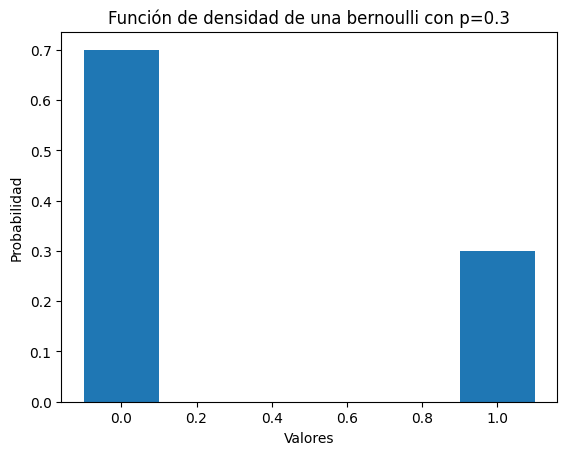

La esperanza es =  0.3
La varianza es =  0.21


In [28]:
from scipy.stats import bernoulli

#Definimos nuestra probabilidad de éxito
p=0.3

#Defino los posibles valores
x=[0,1]

#Calculamos la función de densidad
pmf = bernoulli.pmf(x, p)

print("La función de densidad = ", pmf)

#Graficamos la función de densidad
plt.bar(x,pmf,width=0.2)
plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title('Función de densidad de una bernoulli con p=0.3')
#plt.grid(True)
plt.show() #mostrar el gráfica

#Calculo de la esperanza
print("La esperanza es = ", bernoulli.mean(p))

#Calculo de la varianza
print("La varianza es = ", bernoulli.var(p))

### 1.1.3 Variable aleatoria Binomial

Decimos que una v.a. $X$ tiene distribución binomial con parámetros $n$ y $p$, si su función de densidad está dada por
$$ f_X(x) = \mathbb{P}(X=x) = \begin{cases} \binom{n}{x}p^x (1-p)^{n-x}, \quad \text{si } x\in \{0,1,...,n\} \\
0, \quad \text{e.o.c} \end{cases}$$
donde $n\in\mathbb{Z}_{+}$ y $0<p<1$.

**Obs:** Los ensayos deben ser independientes.

La esperanza de $X$ es
$$\begin{align*}
\mathbb{E}[X]&= np.
\end{align*}$$
y
$$ \begin{align*}
\mathbb{E}[X^2]&= \ (np)^2 +np(1-p),
\end{align*} $$

Por lo que la varianza de $X$ es
$$\text{Var}(X) = np(1-p) $$

### Ejemplo

Una moneda justa se tira seis veces, donde la probabilidad de obtener sol es de $0.3$. Sea $X$ el número de veces que cae sol, entonces dabemos que $X$ tiene una distribución binomial con parámetros $n=6$ y $p=0.3$. Calcular:

- $\mathbb{P}(X=2) = \binom{6}{2}(0.3)^2 (1-p)^{6-2} = 0.3241$
- $\mathbb{P}(X=3) = \binom{6}{3}(0.3)^3 (1-p)^{6-3} = 0.1852$
- $$ \begin{align*} \mathbb{P}(1<X \le 5) &= \mathbb{P}(X=2) + \mathbb{P}(X=3) \mathbb{P}(X=4) + \mathbb{P}(X=5) \\
    &= 0.3241 + 0.1852 + \binom{6}{4}(0.3)^4 (1-p)^{6-4} + \binom{6}{5}(0.3)^5 (1-p)^{6-5}  \\
    &= 0.579 \end{align*} $$

Para más información, ver [Binomial](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.binom.html)

Notemos que $\mathbb{P}(1<X\le 5) = F_X(5) - F_X(1) $

Usamos el atributo `.cdf ` para calcular estas probabilidades

In [33]:
binom.cdf(5,6,0.3) # calcula la probabilidad acumulada de que haya 5 o menos éxitos en 6 ensayos
binom.cdf(1,6,0.3) # calcula la probabilidad acumulada de que haya 1 o menos éxitos en 6 ensayos
binom.cdf(5,6,0.3)-binom.cdf(1,6,0.3) # calcula la probabilidad deseada

np.float64(0.5790960000000003)

##### Gráfica de la distribución Binomial

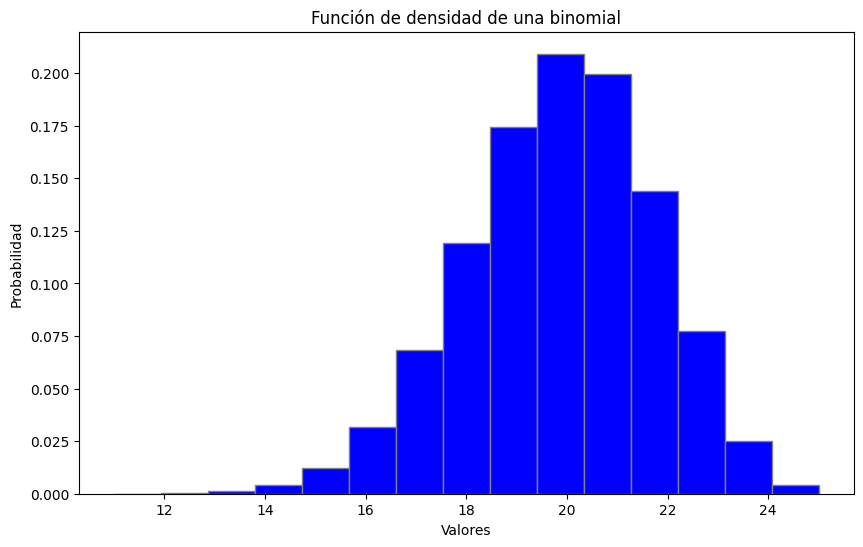

In [34]:
n = 25 # número de ensayos bernoulli
p = 0.8 # probabilidad de éxito
s= 100000 # número de muestras

#Vamos a generar numeros aleatorios que siguen una distribución binomial
binom_numeros = sps.binom.rvs(n,p,size=s)

#Creamos un histograma
plt.figure(figsize=(10,6))
plt.hist(
    binom_numeros,
    density=True, # Normaliza el area para que sea 1
    bins=len(np.unique(binom_numeros)), # número de barras del histograma
    color = "blue",
    edgecolor="grey"
)

plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title('Función de densidad de una binomial')
#plt.grid(True)
plt.show() #mostrar el gráfica

### 1.1.4 Variable aleatoria Poisson

Es una distribución de probabilidad discreta que sirve para calcular la probabilidad de que ocurra un determinado número de eventos raros durante un intervalo dado (puede ser tiempo, lingitud, área, etc).

Esta v.a. tomavalores sobre el conjunto $\{0,1,2,...\}$ y tiene un parámetro $\lambda>0$, el cual representa el número de veces que se **espera** que ocurra un evento durante un intervalo dado.

Su función de densidad, está dado como sigue:
$$ f_X(x) = \mathbb{P}(X=x) = \begin{cases} e^{-\lambda}\frac{\lambda^x}{x!}, \quad \text{si } x\in \{0,1,...\} \\
0, \quad \text{e.o.c} \end{cases}$$

Notemos que $\mathbb{E}[X]=\lambda$ y que $\text{Var}(X)=\lambda$.


### Ejemplo

Supongamos que el número de accidentes que ocurre en un punto en un día tiene distribución Poisson con parámetro $\lambda=2$,

- ¿cuál es la probabilidad de que en un día ocurran más de dos accidentes?
  $$ \begin{align*} \mathbb{P}(X>2) &= 1- \mathbb{P}(X\le 2) \\
    &= 1- [\mathbb{P}(X=0) + \mathbb{P}(X=1) + \mathbb{P}(X=2)] \\
    &= 1- \left[ e^{-2}\frac{2^0}{0!} + e^{-2}\frac{2^1}{1!} + e^{-2}\frac{2^2}{2!} \right] \\
    &= 1 - e^{-2}[1+2+2] = 1-5e^{-2} = 0.3233
    \end{align*} $$
- ¿cuál es la probabilidad de que ocurran más de dos accidentes sabiendo que por lo menos ocurre uno?
  $$ \begin{align*} \mathbb{P}(X>2 \mid X \ge 1) &= \frac{\mathbb{P}(\{X>2\} \cap \{X \ge 1\} )}{\mathbb{P}\{X \ge 1)\}} \\
       &= \frac{\mathbb{P}(\{X>2\})}{\mathbb{P}\{X \ge 1)\}} \\
       & = \frac{.3233}{1-\mathbb{P}(X<1)} = \frac{0.3233}{1-e^{-2}} \frac{0.3233}{.8646} = 0.3739
       \end{align*} $$

### Ejercicios

$\color{red}{\text{Ejercicio 3.}}$ Usando el atributo `.cdf` [Poisson](https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.poisson.html) calcula las probabilidades anteriores.

In [40]:
lam = 2
P_2 = sps.poisson.cdf(2, lam)
P_may2 = 1 - P_2

printmd(f'$P(X > 2) = {P_may2:.3f}$')

P_1 = sps.poisson.cdf(0, lam)
P_may1 = 1 - P_1
P_2_1 = P_may2 / P_may1

printmd(f'$P(X > 2 \\mid X\\geq 1) = {P_2_1:.3f}$')

$P(X > 2) = 0.323$

$P(X > 2 \mid X\geq 1) = 0.374$

##### Aproximación de Poisson a la Binomial
La distribución de Poisson es una forma límite de la distribución binomial, es decir, es una buena aproximación cuando $n$ es suficientemente grande y $p$ suficientemente pequeña.

$\textbf{Teorema (Poisson).-}$ Sean $S_{n}\sim Bin(n,p_{n})$ bajo el regimen $$\lim_{n\to \infty}np_{n}=\lambda>0.$$
Consideremos la siguiente sucesión de números reales:
$$a_{j}(n,p_n)=\begin{cases}\binom{n}{j}(p_n)^{j}(1-p_{n})^{n-j} & j\leq n\\
0 & j\geq n+1\end{cases}$$

 Entonces,
 $$\lim_{n\to \infty}a_{j}(n,p_n)=a_{j}=e^{-\lambda}\frac{\lambda^{j}}{j!} \ \ \forall j\in \mathbb{N}.$$

 El teorema anterior implica que la distribución de Poisson ofrece un modelo probabilístico adecuado para todos aquellos experimentos aleatorios 	en los que las repeticiones son independientes unas de otras y en los 	que sólo hay dos posibles resultados: éxito o fracaso, con probabilidad de 	éxito pequeña, y en los que el interés se centra en conocer el número de éxitos obtenidos al realizar el experimento un número suficientemente grande de veces.

Empíricamente se ha establecido, que la aproximación se puede aplicar con seguridad si $n\ge100$, $p\le 0.01$ y $np \le20$.

**Ejemplo** Supongamos que la probabilidad de que un producto producido por cierta máquina es defectuoso es de $0.1$. ¿Cuál es la probabilidad de que un lote de 10 productos contenga a lo más un producto defectuoso?

Sea $X$ el número de productos defectuosos, y sabemos que $X$ tiene una distribución binomial con parámetros $n=10$ y $p=0.1$, entonces
\begin{align*}
\mathbb{P}(X\le 1) &= \mathbb{P}(X=0)+\mathbb{P}(X=1) \\ &= \binom{10}{0}(0.1)^{0}(0.9)^{10-0}+\binom{10}{1}(0.1)^{1}(0.9)^{10-1} \\ &= 0.7361
	\end{align*}

Ahora, con la distribución Poisson, tenemos que $\lambda=10(0.1)=1$, por lo que
$$\mathbb{P}(X\le 1) = \mathbb{P}(X=0)+\mathbb{P}(X=1) = \frac{e^{-1}1^{0}}{0!}+\frac{e^{-1}1^{1}}{1!} = e^{-1}+e^{-1} =0.7358$$

##### Gráfica de la aproximación de la binomial a la Poisson

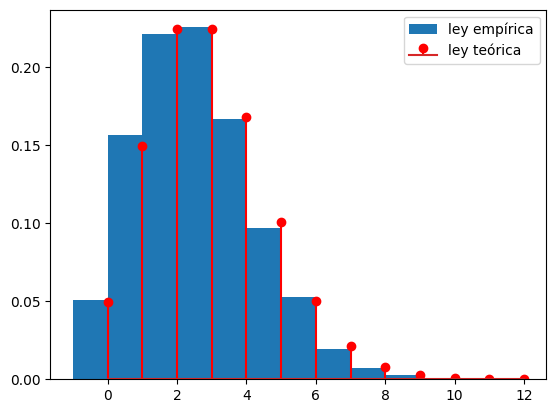

In [42]:
# Simulación de la aproximación de la Bonomial a la Poisson
param=3 # Parametro de la Poisson que queremos aproximar
n=1000 # Este es el número de ensayos en la distribución binomial
N=5000 # Este es el número de simulaciones que realizaremos.

# Genera una muestra de N valores aleatorios de una distribución binomial con parámetros:
# n = 1000 (número de ensayos), p = param/n = 3/1000
X=npr.binomial(n,param/n,N)

# Calcular la frecuencia relativa de los valores simulados
counts = np.bincount(X) / float(N)

# Crear un array de valores posibles
x = np.arange(len(counts))

# Calcular la función de masa de probabilidad (FMP) de la distribución Poisson teórica
f_x = sps.poisson.pmf(x, param)

plt.close()
plt.bar(x - 0.5, counts, width=1., label="ley empírica")
p2 = plt.stem(x, f_x, "r", label="ley teórica")
plt.legend()
plt.show()

### 1.1.5 Variable aleatoria Geométrica 

Esta variable aleatoria cuenta el número de fracasos antes del primer éxito en ensayos bernoulli independientes con parámetro $0<p<1$, y su función de masa de probabilidades está dada por:
$$f_{X}(x)=\begin{cases}
	p(1-p)^{x-1} &\quad \text{si } x=1,2,\dots \\
	\qquad 0 &\quad \text{en otro caso}  
\end{cases}$$


**Notación:** $X\sim Geo(p)$

La cual es una función de densidad ya que:
* $0\le f_{X}(x)\le 1$ para toda $x$.
* $$\begin{align*}
	\sum_{x\in R_{X}}f_{X}(x) &= \sum_{x=1}^{\infty}(1-p)^{x-1}p \\
	&= p\sum_{y=0}^{\infty}(1-p)^{y} \\
	&= p\left(\frac{1}{1-(1-p)}\right) = 1
    \end{align*}$$

Si por el contrario queremos contar el número de éxitos antes del primer fracaso, tenemos que la función de está dada por:
$$f_{X}(x)=\begin{cases}
	p^{x}(1-p) &\quad \text{si } x=0,1,2,\dots \\
	\qquad 0 &\quad \text{en otro caso}  
\end{cases}$$

Para calcular la esperanza 

Se tiene
$$\mathbb{E}[X]=\frac{1}{p}.$$

Por lo tanto,
$$\text{Var}(X)=\frac{1-p}{p^2}.$$

### Ejemplo

##### Gráfica de la distribución geométrica

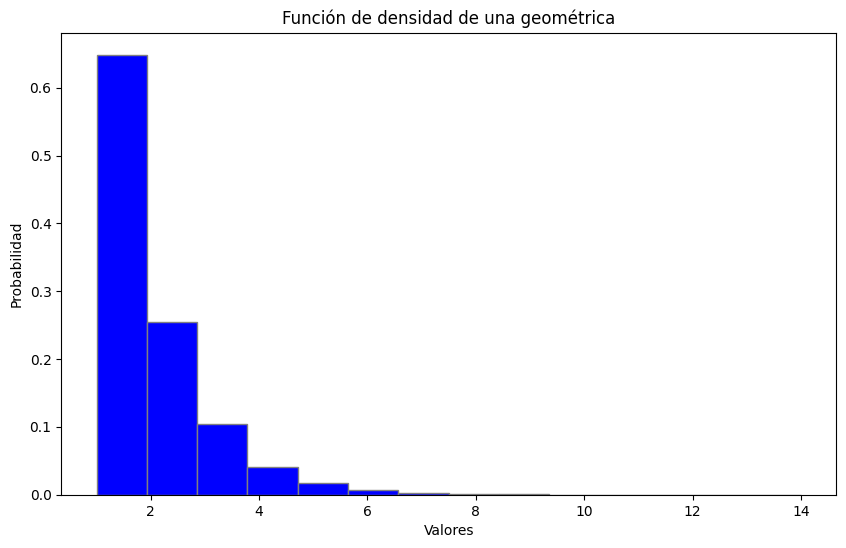

In [45]:
p = 0.6 # probabilidad de éxito
s= 100000 # número de muestras

random.seed(3) #fijar una semilla
#Vamos a generar numeros aleatorios que siguen una distribución geométrica
geom_numeros = sps.geom.rvs(p,size=s)

#Creamos un histograma
plt.figure(figsize=(10,6))
plt.hist(
    geom_numeros,
    density=True, # Normaliza el area para que sea 1
    bins=len(np.unique(geom_numeros)), # número de barras del histograma
    color = "blue",
    edgecolor="grey"
)

plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title('Función de densidad de una geométrica')
plt.show() #mostrar el gráfica

### 1.1.6 Variable aleatoria Binomial Negativa

Supongamos que se realizan ensayos independientes, cada uno con probabilidad $0<p<1$ de ser un éxito, hasta obtener un total de $r$ éxitos acumulados. Sea $X$ el número de ensayos que se requieren, entonces su función de masa de probabilidades está dada por:
$$ f_{X}(x)=\begin{cases}
	\binom{x-1}{r-1}p^{r}(1-p)^{x-r} &\quad \text{si } x=r,r+1,\dots \\
	\qquad 0 &\quad \text{en otro caso}  
\end{cases}$$

**Notación.** $X\sim \text{BN}(r,p)$.

Se tiene que
$$ \mathbb{E}[X]=\frac{r}{p}$$
y
$$ \text{Var}[X]=\frac{r(1-p)}{p^2}.$$

### Ejemplos

##### Gráfica de la distribución Binomial Negativa

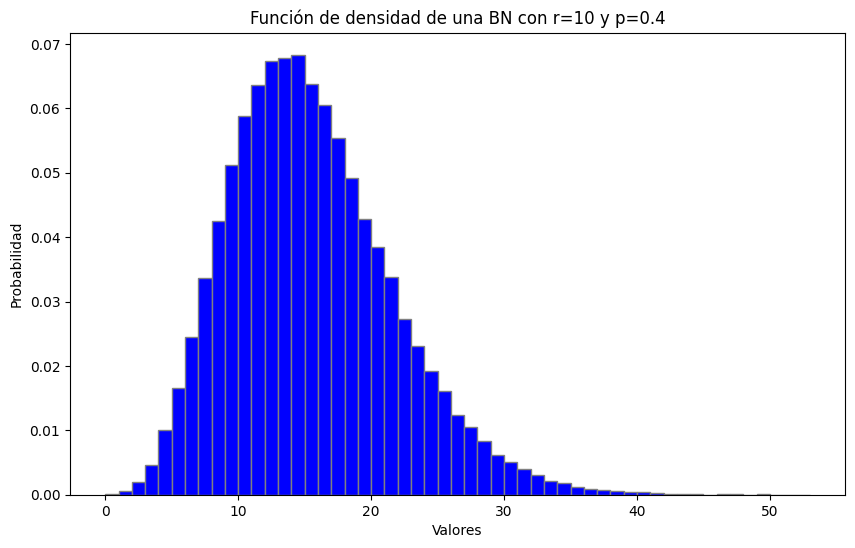

In [50]:
r = 10
p = 0.4 # probabilidad de éxito
s= 100000 # número de muestras

random.seed(3) #fijar una semilla
#Vamos a generar numeros aleatorios que siguen una distribución geométrica
nbinom_numeros = sps.nbinom.rvs(r,p,size=s)

#Creamos un histograma
plt.figure(figsize=(10,6))
plt.hist(
    nbinom_numeros,
    density=True, # Normaliza el area para que sea 1
    bins=len(np.unique(nbinom_numeros)), # número de barras del histograma
    color = "blue",
    edgecolor="grey"
)

plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title('Función de densidad de una BN con r=10 y p=0.4')
plt.show() #mostrar el gráfica

### Ejercicios 

$\color{red}{\text{Ejercicio 4.}}$ Un examen de Estadística consta de 20 preguntas tipo test y se conoce de experiencias
anteriores que un alumno tiene probabilidad 0.7 de contestar bien cada pregunta. Obtener:

a) La probabilidad de que la primera pregunta que contesta bien sea la cuarta.

b) Sabiendo que para aprobar el examen es necesario contestar bien a 10 preguntas, ¿cuál es la probabilidad de que apruebe al contestar la pregunta duodécima?



In [53]:
p = 0.7

printmd('Inciso a (dist. geom.):')

P_4 = sps.geom.pmf(4, p)

printmd(f'$P(X = 4) = {P_4:.3f}$')

printmd('Inciso b (dist. neg-binom.):')

r = 10

P_12 = sps.nbinom.pmf(2, r, p)
printmd(f'$P(X = 12) = {P_12:.3f}$')

Inciso a (dist. geom.):

$P(X = 4) = 0.019$

Inciso b (dist. neg-binom.):

$P(X = 12) = 0.140$

$\color{red}{\text{Ejercicio 5.}}$ Investigue sobre el problema de la caja de cerillos de Banach y explique su solución.

---

El problema de Banach establece que un fumador compra 2 cajas de cerillos con $N$ cantidad de cerillos cada una. Después de un tiempo, al sacar abrir de las cajas, la encuentra vacía. Por ende, se plantea cuál sería la probabilidad de que en la otra caja de cerillos aún queden $k$ cantidad de cerillos.

La solución de este problema viene de establecer la solución considerando que, para que queden $k$ cantidad de cerillos en una caja, la otra debió ser escogida $N - k$ veces. Esto se condensa en una distribución binomial $X \sim NB(N - k, 1/2)$, donde el $1/2$ resulta de saber que la probabilidad de cualquiera de las dos cajas para ser escogidas es del $50\%$. Dicho esto, la función de probabilidad resulta en:

$$
P(X = N - k) = {2N - k \choose N - k}\left(\frac{1}{2}\right)^{2N - k + 1}
$$

Pero, considerando que esto aplica tanto para la primera caja como para la segunda, se duplica esta función de probabilidad, resultando en:

$$
P(X = N - k) = {2N - k \choose N - k}\left(\frac{1}{2}\right)^{2N - k}
$$

##### Variable aleatoria Hipergeométrica

Supongamos que se elige, sin reemplazo, una muestra de tamaño $n$ de una urna que contiene $N$ bolas, de las cuales $m$ son rojas y $N-m$ son verdes. Sea $X$ el número de bolas rojas seleccionadas, entonces su función de masa de probabilidades está dada por:
$$ f_{X}(x)=
	\frac{\binom{m}{x}\binom{N-m}{n-x}}{\binom{N}{n}} \quad \text{si } x=0,1,\dots, n $$

**Notación.** $X\sim \text{Hiper}(n,N,m)$.

Se tiene que
$$ \mathbb{E}[X]=\frac{nm}{N}$$
y
$$ \text{Var}[X]=\frac{nm}{N}\left[\frac{(n-1)(m-1)}{N-1}+1-\frac{nm}{N} \right].$$

**Nota.** Si $x\leq n$ y $X\sim \text{Hiper}(n,N,m)$, cuando $p=\frac{m}{N}$ y $m,N$ son muy grandes con respecto a $n$ y $x$:
$$\mathbb{P}(X=x)\approx \binom{n}{x}p^{x}(1-p)^{n-x}.$$

$\color{red}{\text{Ejercicio 6.}}$ Replicar la grafica de la función de densidad

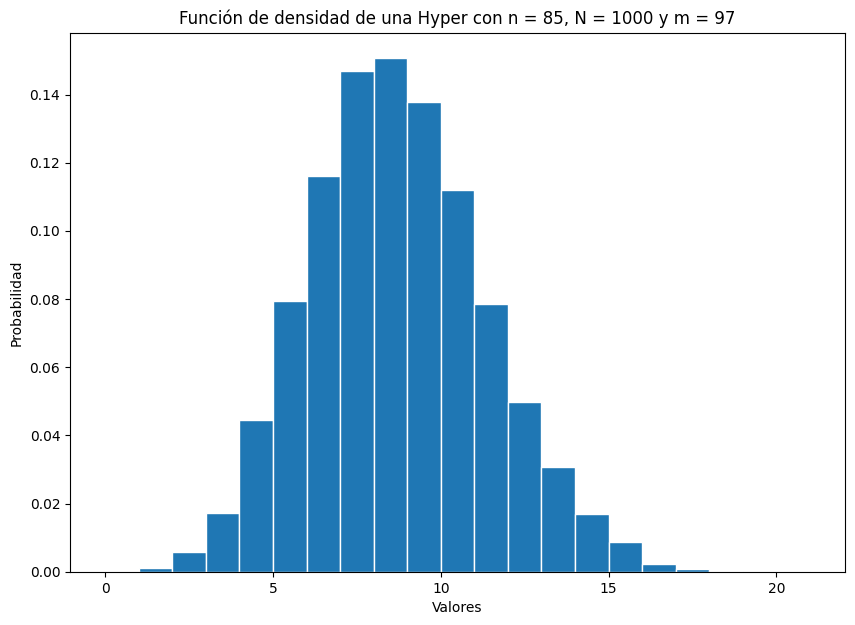

In [58]:
n = 85
N = 1000
m = 97
size = 10000

random.seed(10)
rand_hyper = sps.hypergeom.rvs(N, n, m, size=size)

plt.figure(figsize=(10, 7))
plt.hist(rand_hyper, density=True, bins=len(np.unique(rand_hyper)), 
         color='tab:blue', edgecolor='white')

plt.xlabel('Valores')
plt.ylabel('Probabilidad')
plt.title(f'Función de densidad de una Hyper con n = {n}, N = {N} y m = {m}')
plt.show()

$\color{red}{\text{Ejercicio 7.}}$ Una compañía petrolera realiza un estudio geológico que indica que un pozo petrolero exploratorio debería tener un 20% de posibilidades de encontrar petróleo.

- ¿Cuál es la probabilidad de que el primer pozo se produzca en el tercer pozo perforado?

- ¿Cuál es la probabilidad de que el tercer pozo se produzca en el séptimo pozo perforado?

- ¿Cuál es la media y la varianza del número de pozos que se deben perforar si la compañía petrolera quiere establecer tres pozos productores?

In [60]:
p = 0.2

printmd('Inciso a (dist. geom.):')

P_3 = sps.geom.pmf(3, p)
printmd(f'$P(X = 3) = {P_3:.3f}$')

printmd('Inciso b (dist. neg-binom.):')
r = 3 
x = 7

P_7 = sps.nbinom.pmf(x - r, r, p)
printmd(f'$P(X = 7) = {P_7:.3f}$')

printmd('Inciso c (dist. neg-binom.):')

media = r / p
varianza = r * (1 - p) / p**2

printmd(f'$\\mu = {media}$')
printmd(f'$\\sigma = {varianza}$')


Inciso a (dist. geom.):

$P(X = 3) = 0.128$

Inciso b (dist. neg-binom.):

$P(X = 7) = 0.049$

Inciso c (dist. neg-binom.):

$\mu = 15.0$

$\sigma = 60.0$

## 2.1 Continuas

$$ F_X(x) = \mathbb{P}(X\leq x) = \int_{-\infty}^{x}f_X(t)dt$$
existe $f_X$ que es la función de densidad.

Podemos encontrar $f_X$ de $X$, como sigue:
$$ \frac{dF_X(x)}{dx} =f_X(x)$$

### 2.1.1 Variables aleatorias (abolutamente) continuas

#### 2.1.2 Variable aleatoria uniforme sobre el intervalo $(a,b)$.

Una variable aleatoria $X$ se dice que tiene distribución uniforme continua  en el intervalo $(a,b)$ con $a,b\in\mathbb{R}$, si su función de densidad esta dada por:
$$f_{X}(x)=\begin{cases}
	\frac{1}{b-a} &\quad \text{si } a< x < b\\
	\qquad 0 &\quad \text{en otro caso}  
\end{cases}$$

**Notación.** $X\sim \text{Unif}(a,b)$ $\text{Unif}[a,b]$

**Obs:**
* La distribución uniforme continua en $(a,b)$ es simétrica.
* A los intervalos de la misma longitud contenidos en $(a,b)$ se les asigna la misma probabilidad. Esto se representa gráficamente con la probabilidad de que $X$ se encuentre en el intervalo $(s,t)$:


La función de distribución de $X\sim Unif((a,b))$ esta dada por:
$$F_{X}(x)=\begin{cases}
	 0 &\quad \text{si } x\le a \\
	\frac{x-a}{b-a} &\quad \text{si } a<x<b\\
	 1 &\quad \text{si } x\ge b  
\end{cases}$$

La esperanza de una variable aleatoria uniforme es la siguiente,
$$\begin{align*}
\mathbb{E}[X] & = \frac{a+b}{2}.
\end{align*}$$

Para calcular la varianza, primero vamos a calcular el segundo momento
$$\begin{align*}
\mathbb{E}[X^{2}] &= \int_{a}^{b}x^{2}f_{X}(x)dx = \int_{a}^{b}x^{2}\frac{1}{b-a}dx = \frac{1}{b-a}\int_{a}^{b}x^{2}dx \\ &= \frac{1}{b-a}\left[\frac{x^{3}}{3}\right]_{a}^{b} = \frac{1}{b-a}\left[\frac{b^{3}}{3}-\frac{a^{3}}{3}\right] =  \frac{b^{3}-a^{3}}{3(b-a)}.
\end{align*}$$

Por lo que se tiene lo siguiente

$$Var(X)  = \frac{(b-a)^{2}}{12}.$$

### Ejemplos

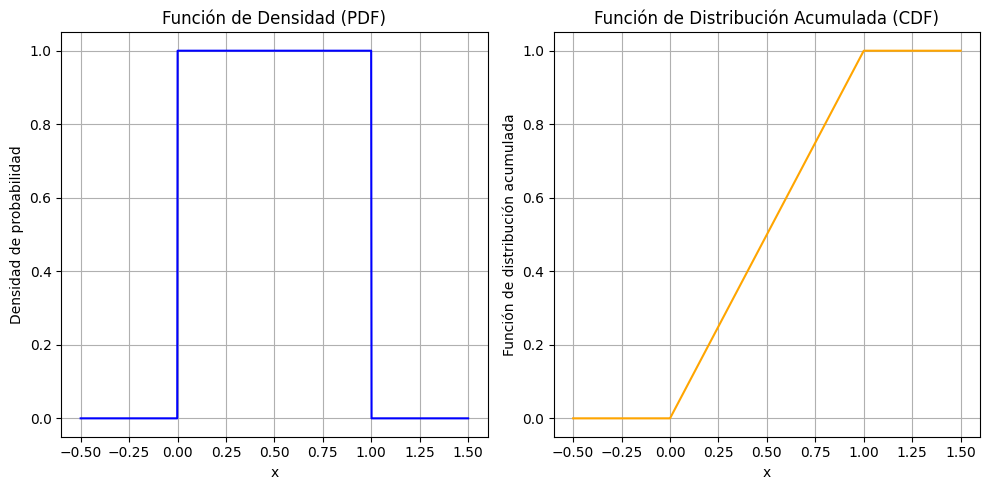

In [68]:
# Parámetros de la distribución uniforme
a = 0  # límite inferior
b = 1  # límite superior

# Definimos las funciones de densidad y distribución
# Función de densidad (pdf) de la distribución uniforme
def uniform_pdf(x, a, b):
    return np.where((x >= a) & (x <= b), 1 / (b - a), 0)

# Función de distribución (cdf) de la distribución uniforme
def uniform_cdf(x, a, b):
    return np.where(x < a, 0, np.where(x > b, 1, (x - a) / (b - a)))
    
# Generar valores de x
x = np.linspace(-0.5, 1.5, 1000)

# Calcular la función densidad 
pdf_values = uniform_pdf(x, a, b)

# Calcular la función de distribución
cdf_values = uniform_cdf(x, a, b)

# Graficar la PDF
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(x, pdf_values, label='PDF', color='blue')
plt.xlabel('x')
plt.ylabel('Densidad de probabilidad')
plt.title('Función de Densidad (PDF)')
plt.grid(True)

# Graficar la CDF
plt.subplot(1, 2, 2)
plt.plot(x, cdf_values, label='CDF', color='orange')
plt.xlabel('x')
plt.ylabel('Función de distribución acumulada')
plt.title('Función de Distribución Acumulada (CDF)')
plt.grid(True)

plt.tight_layout()
plt.show()

Sea $X\sim Unif((-3,2))$. Vamos a calcular: $P(X\ge 0)$ y
$P(-5 \le X \le 1/2)$.
**Solución.** La función de densidad de esta variable aleatoria esta dada por:
$$f_{X}(x)=\begin{cases}
	\quad \frac{1}{5} &\quad \text{si } -3\le x \le 2\\
	\quad 0 &\quad \text{e.o.c}  
\end{cases}$$
Entonces,

$$\begin{align}
\mathbb{P}(X\ge 0) &= \int_{0}^{2}\frac{1}{5}dx=\frac{1}{5}x\Big|_{0}^{2}=\frac{2}{5} \\
\mathbb{P}(-5 \le X \le 1/2) &= \int_{-3}^{1/2}\frac{1}{5}dx=\frac{1}{5}x\Big|_{-3}^{1/2}=\frac{1}{5}\left(\frac{1}{2}+3\right)=\frac{7}{10}
\end{align}$$

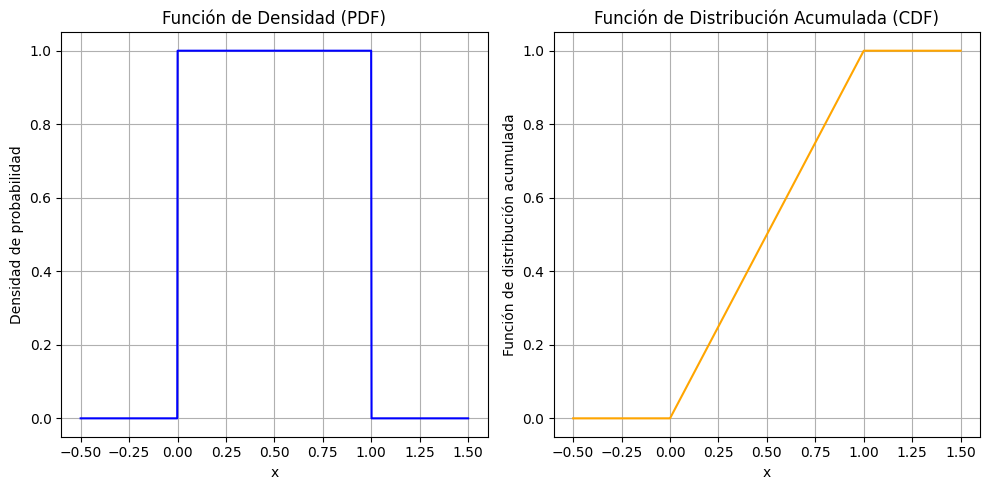

In [69]:
# Parámetros de la distribución uniforme
a = 0  # límite inferior
b = 1  # límite superior

# Crear el objeto de distribución uniforme usando scipy
uniform_dist = uniform(loc=a, scale=b-a)

# Generar valores de x
x = np.linspace(-0.5, 1.5, 1000)

# Calcular la PDF usando scipy
pdf_values = uniform_dist.pdf(x)

# Calcular la CDF usando scipy
cdf_values = uniform_dist.cdf(x)

# Graficar la PDF
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(x, pdf_values, label='PDF', color='blue')
plt.xlabel('x')
plt.ylabel('Densidad de probabilidad')
plt.title('Función de Densidad (PDF)')
plt.grid(True)

# Graficar la CDF
plt.subplot(1, 2, 2)
plt.plot(x, cdf_values, label='CDF', color='orange')
plt.xlabel('x')
plt.ylabel('Función de distribución acumulada')
plt.title('Función de Distribución Acumulada (CDF)')
plt.grid(True)

plt.tight_layout()
plt.show()

$$\mathbb{P}(X\ge 0) = 1-\mathbb{P}(X<0) = 1-F_X (0)$$

$$F_X(x):=\mathbb{P}(X\le x)$$


$$\mathbb{P}(-5 \le X \le 1/2) = F_X (1/2)-F_X(-5)$$


### Ejercicios

$\color{red}{\text{Ejercicio 1.}}$ Un alumno se dirige a la biblioteca para solicitar el préstamo de un libro y decide que no puede esperar más de $10$ minutos en ser atendido. Supongamos que el bibliotecario tarda por lo menos $0.5$ minutos en atender a una persona, entonces es razonable proponer una distribución uniforme en el intervalo $[0.5,10]$ para modelar el comportamiento de la variable $X$ que es el tiempo en ser atendido (en  minutos).

- Da la función de densidad y gráfica.
- ¿Cuál es la probabilidad de que el tiempo en ser atendido sea mayor a $5$ minutos pero menor a $8$ minutos?
- ¿Cuál es la esperanza y varianza?
- Calcula la función de distribución y con ella calcula: $\mathbb{P}(2.51\le X \le 7.99)$.

##### Parámetros de la distribución uniforme
dado que la variable $X$ sigue una distribución uniforme en el intervalo [0.5,10], su función de densudad es:
$$f_{X}(x)=\begin{cases}
	\frac{1}{10-0.5} = \frac{1}{9.5} , &\quad 0.5 \le x \le 10 \\
	\qquad 0 &\quad \text{e.o.c}  
\end{cases}$$
Gráficamente, esta función es una línea horizontal con altura $\frac{1}{9.5}$ en el intervalo $[0.5,10]$.

##### 2. Probabilidad de que el tiempo sea mayor a 5 pero menor a 8
Para una distribución uniforme, la probabilidad se calcula con:
$$\mathbb{P}(a\le X \le b) = \frac{b-a}{10-0.5}$$
Sustituyendo los valores:
$$\mathbb{P}(5 \le X \le 8) = \frac{8-5}{9.5}=\frac{3}{9.5} = 0.3158$$

###### 3. Esperanza y varianza
La esperanza y varianza de una distribución uniforme $U(a,b)$ están dadas por:
$$ \mathbb{E}[X] = \frac{a+b}{2} V[X] = \frac{(b-a)^2}{12}$$
Sustituyendo: 
$$ \mathbb{E}[X] = \frac{0.5+10}{2} = \frac{(10.5)^2}{2}=5.25$$
$$ V[X]=\frac{(10-0.5)^2}{12}=\frac{9.5^2}{12}=\frac{90.25}{12}=7.52$$

##### 4. Función de distribución acumulativa (CDF)
La CDF de una uniforme $U(a,b)$ es:
$$F_{X}(x)=\begin{cases}
	 0 &\quad \text{si } x\le 0.5 \\
	\frac{x-0.5}{9.5} &\quad \text{si } 0.5<x<10\\
	 1 &\quad \text{si } x\ge 10  
\end{cases}$$

Para calcular $P(2.51 \le X \le 7.99)$, usamos la CDF:
$$ P(2.51 \le X \le 7.99) = F(7.99)-F(2.51)$$
$$ F(7.99)=\frac{7.99-0.5}{9.5}=\frac{7.49}{9.5}=0.7884$$
$$ F(2.51)=\frac{2.51-0.5}{9.5}=\frac{2.01}{9.5}=0.22116$$
$$ P(2.51 \le X \le 7.99)=0.7884-0.2116=0.5768$$

dado que la variable $X$ sigue una distribución uniforme en el intervalo [0.5,10], su función de densudad es:
$$f_{X}(x)=\begin{cases}
	\frac{1}{10-0.5} = \frac{1}{9.5} , &\quad 0.5 \le x \le 10 \\
	\qquad 0 &\quad \text{e.o.c}  
\end{cases}$$
Gráficamente, esta función es una línea horizontal con altura $\frac{1}{9.5}$ en el intervalo $[0.5,10]$.

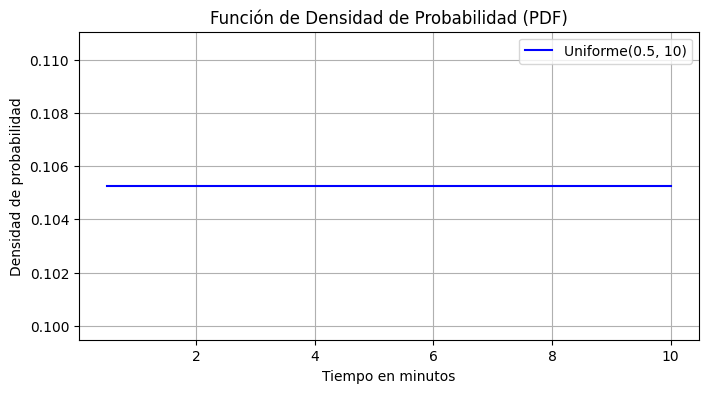

P(5 ≤ X ≤ 8) = 0.3158
Esperanza E[X]: 5.25
Varianza V[X]: 7.52


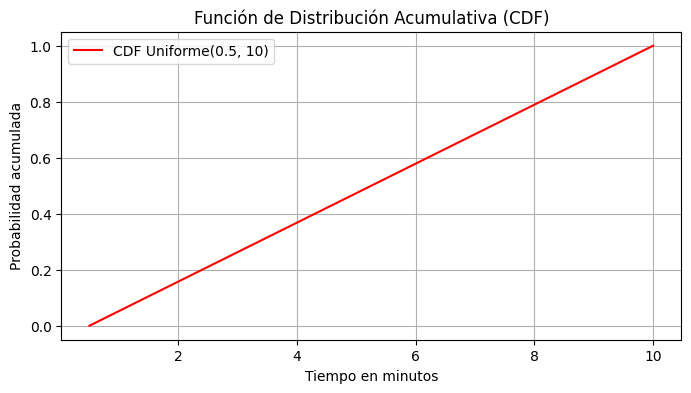

P(2.51 ≤ X ≤ 7.99) = 0.5768


In [77]:
# Definir los parámetros de la distribución uniforme
a, b = 0.5, 10  # Intervalo [0.5, 10]

# Calcular la función de densidad (PDF)
x = np.linspace(a, b, 1000)
pdf = uniform.pdf(x, loc=a, scale=b-a)

# Graficar la función de densidad
plt.figure(figsize=(8, 4))
plt.plot(x, pdf, label=f'Uniforme({a}, {b})', color='blue')
plt.xlabel('Tiempo en minutos')
plt.ylabel('Densidad de probabilidad')
plt.title('Función de Densidad de Probabilidad (PDF)')
plt.legend()
plt.grid()
plt.show()

# Calcular la probabilidad de que el tiempo esté entre 5 y 8 minutos
p_5_8 = uniform.cdf(8, loc=a, scale=b-a) - uniform.cdf(5, loc=a, scale=b-a)
print(f'P(5 ≤ X ≤ 8) = {p_5_8:.4f}')

# Calcular esperanza y varianza
esperanza = (a + b) / 2
varianza = ((b - a) ** 2) / 12
print(f'Esperanza E[X]: {esperanza:.2f}')
print(f'Varianza V[X]: {varianza:.2f}')

# Calcular la función de distribución acumulativa (CDF) y graficarla
cdf = uniform.cdf(x, loc=a, scale=b-a)
plt.figure(figsize=(8, 4))
plt.plot(x, cdf, label=f'CDF Uniforme({a}, {b})', color='red')
plt.xlabel('Tiempo en minutos')
plt.ylabel('Probabilidad acumulada')
plt.title('Función de Distribución Acumulativa (CDF)')
plt.legend()
plt.grid()
plt.show()

# Calcular P(2.51 ≤ X ≤ 7.99) usando la CDF
p_251_799 = uniform.cdf(7.99, loc=a, scale=b-a) - uniform.cdf(2.51, loc=a, scale=b-a)
print(f'P(2.51 ≤ X ≤ 7.99) = {p_251_799:.4f}')

#### 2.1.3 Variable aleatoria exponencial con parámetro $\lambda >0$.

La distribución exponencial es una de las distribuciones continuas más utilizadas. A menudo se utiliza para modelar el tiempo transcurrido entre eventos.  

Algunos ejemplos en los que podría utilizarse la distribución exponencial son:
* El tiempo transcurrido en un call center hasta recibir la primer llamada del día.
* El  tiempo entre terremotos de una determinada magnitud.
* Supongamos una máquina que produce hilo de alambre, la cantidad de metros de alambre hasta encontrar una falla en el alambre se podría modelar como una exponencial.

Se dice que la variable aleatoria $X$ tiene distribución exponecial de parámetro $\lambda>0$, si su función de densidad está dada por:
$$f_{X}(x)=\begin{cases}
\lambda e^{-\lambda x} & x>0\\
0 & \text{en otro caso}
\end{cases}$$


Notación. $X\sim \exp(\lambda).$

$\textbf{Propiedad de pérdida de memoria:}$
$$\mathbb{P}(X>t+s \mid X>t)=\mathbb{P}(X>s)=e^{-\lambda s}.$$

Ejercicio: Demostrar la propiedad de pérdida de memoria para $X\sim \exp(\lambda)$.

Ejemplo: hipótesis natural para modelar las duraciones de vida de átomos radioactivas (Rutherford y Soddy). Cada átomo radioactivo posee una duración de vida que sigue una ley exponencial. En este campo, el parámetro $\lambda$ se llama la constante de desintegración.

 Si $t\mapsto \rho(t)=\mathbb{P}(X>t)$ verifica
$$\rho(t+s)=\rho(t)\rho(s),$$
de manera que (derivando en $s$, con $s=0$),
$$\rho^{\prime}(t)=-\rho(t)\lambda \qquad \ \lambda=-\rho^{\prime}(0)\geq 0.$$
Así,
$$\rho(t)=e^{-\lambda t} \qquad \text{y} \qquad f(t)=\lambda e^{-\lambda t} \ \  \rho(0)=1.$$



La esperanza y varianza de de una distribución exponencial de la forma $$f_{X}(x)=\begin{cases}
\frac{1}{\lambda} e^{-\frac{x}{\lambda}} & x>0\\
0 & \text{en otro caso}
\end{cases}$$:
$$\mathbb{E}[X]=  \lambda$$
y
\begin{align*}
\text{Var}(X) &= \lambda^{2}
\end{align*}



### Ejemplos


Consideremos la variable aleatoria $X$ como el tiempo (en minutos) entre la llegada de dos personas a la fila  de una sucuarsal bancaria.

Adicionalmente, el banco ha determinado que solo el $10\%$ de las veces, el tiempo que transcurre entre la llegada de una persona y otra es mayor a dos minutos.

Esto permite calcular el valor de $\lambda$, ya que
$$\mathbb{P}(X>2)=0.1$$
entonces
$$1-\mathbb{P}(X\le 2) = 1-F_{X}(2) = 0.1$$

Por lo que $F_{X}(2)= 1-e^{\frac{-2}{\lambda}} =0.9$, entonces
$e^{\frac{-2}{\lambda}}=0.1$. Por lo que
$$\frac{-2}{\lambda}=\ln(0.1) \Rightarrow \lambda=0.87$$
Por lo tanto $X\sim\exp(0.87)$.

Ahora queremos calcular la probabilidad de que entre la llegada de una persona y otra transcurra por lo menos un minuto, lo cual puede calcularse de dos formas:


\begin{align*}
\mathbb{P}(X>1) &= \int_{1}^{\infty}f_{X}(x)dx = \int_{1}^{\infty}\frac{1}{0.87}e^{\frac{-x}{0.87}}dx = 0.32
\end{align*}
\item \begin{align*}
\mathbb{P}(X>1) &= 1-\mathbb{P}(X\le 1) = 1-\left[1-e^{\frac{-1}{0.87}}\right] = -e^{\frac{-1}{0.87}}
\end{align*}

Una propiedad interesante de la distribución exponencial es que puede verse como un análogo continuo de la distribución geométrica. Para ver esto, recuerde el experimento aleatorio detrás de la distribución geométrica: lanza una moneda (repite un experimento de Bernoulli) hasta que observa las primeras caras (éxito).


$\mathbf{Teorema.-}$ Sea $\varepsilon>0$ y $Y_{\epsilon}\sim Geo(p_{\varepsilon})$. Supongamos que nos encontramos en el regimen:
$$\lim_{\varepsilon\to 0}p_{\varepsilon}=0 \qquad \text{y} \qquad \varepsilon^{-1}p_{\varepsilon}\sim \lambda>0$$
   Sea $X_{\varepsilon}:=\varepsilon Y_{\varepsilon}$. Entonces,
   $$\lim_{\varepsilon\to 0}F_{X_{\varepsilon}}(x)=F_{X}(x),$$
   en donde $X\sim \exp(\lambda)$. Este también es un resultado de convergencia en ley.

Visualicemos lo anterior:

También, tenemos el siguiente resultado:

$\mathbf{Teorema.-}$ Sea $X\sim \exp(1)$. Si $Y=\min\{k\in \mathbb{Z}: k\geq \lambda X \}$, con $\lambda>0$, entonces
$$Y\sim Geo\left(p=1-e^{-1/\lambda} \right).$$

### 2.2.1 Variable aleatoria normal con parámetros media $\mu$ y varianza $\sigma^{2}$.

La distribución normal es una de las más importantes y de mayor uso tanto en la teoría de la probabilidad, como en la teoría estadística.

También llamada distribución gaussiana, en honor a Gauss, a quien se considera el padre de ésta distribución.

La importancia de la distribución normal, radica en el famoso Teorema central del límite. Fue descubierta por De Moivre en 1733 como un límite de la distribución binomial.


La importancia de esta distribución radica en que permite modelar numerosos fenómenos naturales, sociales y psicológicos, por ejemplo:
* Estatura
* Efectos de un fármaco
* Consumo de cierto producto por un grupo de individuos
* Coeficiente intelectual
* Nivel de ruido en telecomunicaciones
* Errores cometidos al medir ciertas magnitudes

Además, esta distribución juega un papel de suma importancia en la inferencia estadística.

Se dice que la variable aleatoria $X$ tiene distribución normal de parámetros $\mu$ y $\sigma^{2}$, donde $\mu,\sigma\in\mathbb{R}$ y $\sigma>0$, si su función de densidad está dada por:
$$f_{X}(x)=\begin{cases}
	\frac{1}{\sqrt{2\pi\sigma^{2}}}e^{-\frac{(x-\mu)^{2}}{2\sigma^{2}}} &\quad \text{si }  x \in\mathbb{R} \\
	\qquad 0 &\quad \text{e.o.c}  
\end{cases}$$

**Notación.** $X\sim N(\mu,\sigma^{2})$


Tal curva (**la campana de Gauss-Bell**) es una función que depende de los parámetros $\mu$ y $\sigma^{2}$.


**Observación:** El parámetro $\mu$ se llama *media* y el  parámetro $\sigma^{2}$ se llama *varianza*.

La función de densidad definida anteriormente es efecto función de densidad, ya que
$$\int_{\mathbb{R}}f_{X}(x)dx = \int_{\mathbb{R}}\frac{1}{\sqrt{2\pi\sigma^{2}}}e^{-\frac{(x-m)^{2}}{2\sigma^{2}}}  = 1 $$

Variable aleatoria normal con parámetros  0  y  1 .
La ley de $Z\sim N(0,1)$ está dada por la función de densidad
$$
f_{Z}(z) = \frac{1}{\sqrt{2\pi}}e^{-\frac{z^2}{2}},
$$
para $z\in \mathbb{R}$.

Sabemos que:
* La varianza es usada como una medida para comparar la dispersión en dos o más conjuntos de observaciones.
* Una desviación estándar pequeña indica que los valores de la variable aleatoria se encuentran cercanos a la media.
* Una desviación estándar grande indica que los valores de la variable aleatoria se dispersan mucho con respecto a la media.

La función de distribución de una variable aleatoria $X\sim N(\mu,\sigma^{2})$ está dada por:
$$F_{X}(x) = \int_{-\infty}^{x}\frac{1}{\sqrt{2\pi\sigma^{2}}}e^{-\frac{(y-\mu)^{2}}{2\sigma^{2}}}dy$$

Esta nos proporciona la probabilidad de que $X$ tome calores menores o iguales a un valor específico $x$, y corresponde al área bajo la curva en el intervalo $(-\infty,x]$:

No es sencillo calcular $F_{X}(x)$, pero cualquier v.a. gaussiana puede transformarse a una v.a. estandarizada. Existen tablas para esta v.a., lo cual hace los cálculos más fáciles.

**Proposición**  Sea $X\sim N(\mu,\sigma^{2})$, entonces
$$Z=\frac{X-\mu}{\sigma}$$
tiene una distribución gaussiana con media $0$ y varianza $1$, es decir, $Z\sim N(0,1)$.


**Demostración** 	Primero vamos a calcular la función de distribución de $Z$:
$$F_{Z}(z):=\mathbb{P}(Z\le z) = \mathbb{P}\left(\frac{X-\mu}{\sigma}\le z\right) = \mathbb{P}(X\le \sigma z + \mu) := F_{X}(\sigma z + \mu)$$
Entonces, la función de densidad de $Z$ esta dada por:
$$f_{Z}(z) = \frac{dF_{Z}(z)}{dz} = \frac{dF_{X}(\sigma z + \mu)}{dz} = \sigma f_{X}(\mu+\sigma z) = \frac{e^{-z^{2}/2}}{\sqrt{2\pi}}$$

Decimos que $X$ tiene distribución gaussiana estándar (normal estándar), $X\sim N(0,1)$, si su función de densidad esta dada por:
$$f_{X}(x)=\begin{cases}
	\frac{e^{-x^{2}/2}}{\sqrt{2\pi}} &\quad \text{si }  x \in\mathbb{R} \\
	\quad 0 &\quad \text{e.o.c}  
\end{cases}$$

Podemos calcular cualquier probabilidad de la forma
$$\mathbb{P}(a<X<b)$$
de la siguiente manera: para $z\ge 0$, definimos
$$\Phi(z) = \frac{1}{\sqrt{2\pi}}\int_{0}^{z}e^{-x^{2}/2}dx.$$


### Ejemplos

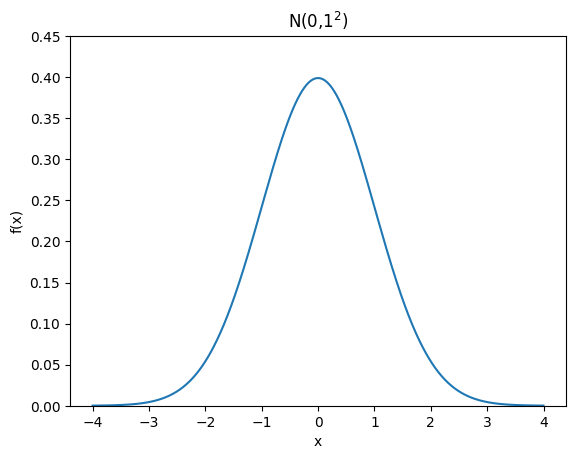

In [78]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
fig, ax = plt.subplots()
x= np.arange(-4,4,0.001) #generar valores de x
ax.set_title('N(0,$1^2$)')
ax.set_xlabel('x')
ax.set_ylabel('f(x)')
ax.plot(x, norm.pdf(x))
ax.set_ylim(0,0.45)
plt.show()

Propiedades de la función de densidad de probabilidades de una distribución normal estándar:

1. Es positiva: $f(x)\geq 0$ para todo $x$ real.
2. Es continua y derivable en todas partes.
3. Es simétrica alrededor de $\mu$.
4. Conforme $x$ toma valores muy grandes de manera positiva y negativa, la función decrece hacia cero muy rápidamente.
5. Tiene un máximo global.
6. El área total bajo la curva es igual a $1$.

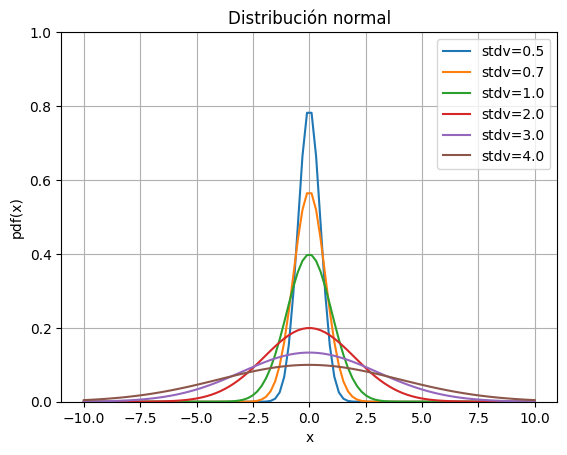

In [80]:
fig, ax = plt.subplots()
x = np.linspace(-10,10,100)
stdvs = [0.5, 0.7, 1.0, 2.0, 3.0, 4.0]
for s in stdvs:
    ax.plot(x, norm.pdf(x,scale=s), label='stdv=%.1f' % s)

ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.set_title('Distribución normal')
ax.legend(loc='best', frameon=True)
ax.set_ylim(0,1)
ax.grid(True)

Veamos el comportamiento de la función conforme se cambia la media.

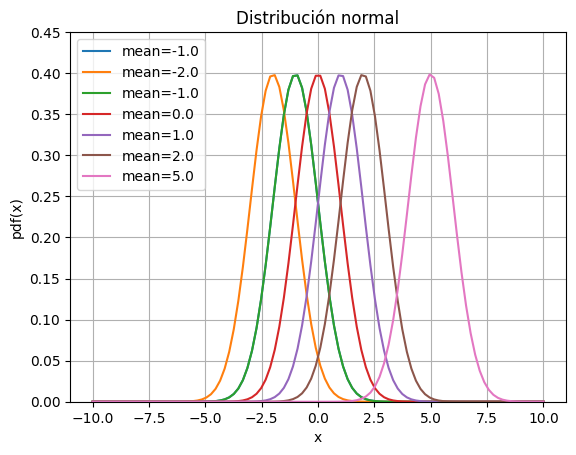

In [81]:
fig, ax = plt.subplots()
x = np.linspace(-10,10,100)
means = [-1.0,-2.0, -1.0, 0.0, 1.0, 2.0, 5.0]
for mean in means:
    ax.plot(x, norm.pdf(x,loc=mean), label='mean=%.1f' % mean)

ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.set_title('Distribución normal')
ax.legend(loc='best', frameon=True)
ax.set_ylim(0,0.45)
ax.grid(True)

#### 2.2.2 Función de distribución acumulativa de una normal $N(\mu,\sigma^2)$.

Gracias a las propiedades anteriores, es posible calcular áreas delimitadas de la función $f$. Si $a$ y $b$ son reales cualesquiera, denotaremos por
$$P(a\leq X\leq b),$$
la probabilidad de que $X$ esté en el intervalo $[a,b]$, al área bajo la curva de $f(x)$ sobre el intervalo $[a,b]$.

También, $P(X\leq x)$ denotara al área bajo la curva de la función $f(x)$ sobre el intervalo $(-\infty,x)$ y $P(X>x)$ denotara al área bajo la curva de la función $f(x)$ sobre el intervalo $(x, \infty)$.

A la probabilidad $\text{cdf}(x):=P(X\leq x)$ se llama la distribución acumulativa (hasta el valor $x$) de $f(x)$.

Con la notación anterior,
$$P(a\leq X\leq b)=\text{cdf}(b)-\text{cdf}(a)$$
y
$$\text{sf}(a):=P(X>a)=1-\text{cdf}(a).$$

### Ejemplos

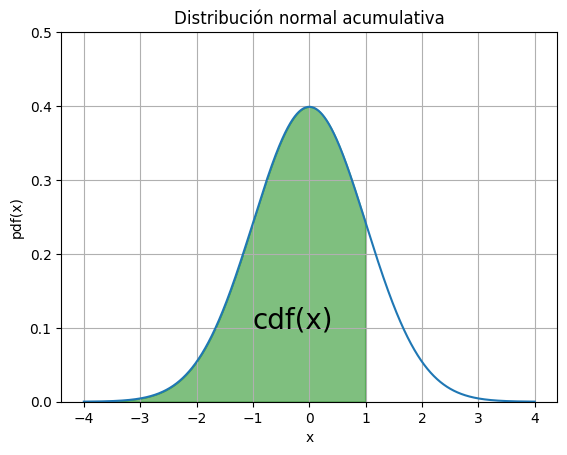

In [82]:
fig, ax = plt.subplots()
# for distribution curve
x= np.arange(-4,4,0.001)
ax.plot(x, norm.pdf(x))
ax.set_title("Distribución normal acumulativa")
ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.grid(True)
# for fill_between
px=np.arange(-4,1,0.01)
ax.set_ylim(0,0.5)
ax.fill_between(px,norm.pdf(px),alpha=0.5, color='g')
# for text
ax.text(-1,0.1,"cdf(x)", fontsize=20)
plt.show()

#### 2.2.3 Cálculo de probabilidades de una distribución normal

Calculemos $\text{cdf}(2)=\mathbb{P}(X<2)$ cuando $X\sim N(3,2^2)$.

$$Z = \frac{X-\mu}{\sqrt{\sigma^2}} \sim N(0,1)$$

### Ejemplo

In [85]:
norm.cdf(x=2, loc=3, scale=2) #v.a. con media=3 y st=2

np.float64(0.3085375387259869)

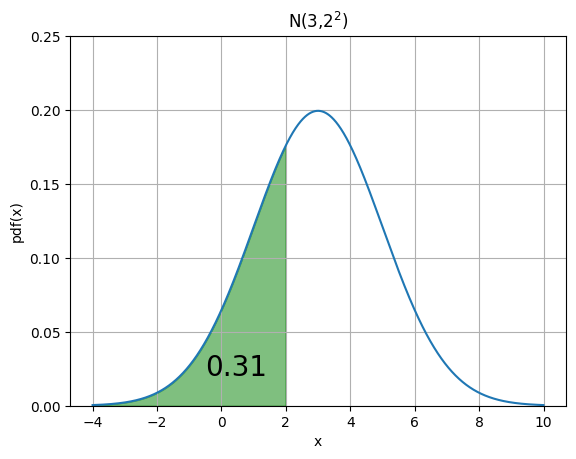

In [86]:
fig, ax = plt.subplots()
# for distribution curve
x= np.arange(-4,10,0.001)
ax.plot(x, norm.pdf(x,loc=3,scale=2))
ax.set_title("N(3,$2^2$)")
ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.grid(True)
# for fill_between
px=np.arange(-4,2,0.01)
ax.set_ylim(0,0.25)
ax.fill_between(px,norm.pdf(px,loc=3,scale=2),alpha=0.5, color='g')
# for text
ax.text(-0.5,0.02,round(norm.cdf(x=2, loc=3, scale=2),2), fontsize=20)
plt.show()

In [87]:
s=np.sqrt(2)
norm(1, s).cdf(2) - norm(1,s).cdf(0.5)

np.float64(0.3984131339906417)

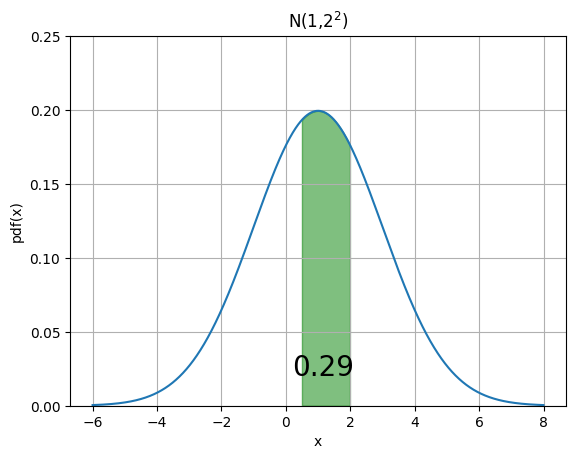

In [88]:
fig, ax = plt.subplots()
x= np.arange(-6,8,0.001)
ax.plot(x, norm.pdf(x,loc=1,scale=2))
ax.set_title("N(1,$2^2$)")
ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.grid(True)
px=np.arange(0.5,2,0.01)
ax.set_ylim(0,0.25)
ax.fill_between(px,norm.pdf(px,loc=1,scale=2),alpha=0.5, color='g')
pro=norm(1, 2).cdf(2) - norm(1,2).cdf(0.5)
ax.text(0.2,0.02,round(pro,2), fontsize=20)
plt.show()

**Ejemplo importante** Si $Z\sim N(0,1)$, encuentra $\mathbb{P}(-1.93 < Z < 1.93)$. La probabilidad buscada es:


In [90]:
norm(0,1).cdf(1.93)-norm(0,1).cdf(-1.93)

np.float64(0.9463931622458901)

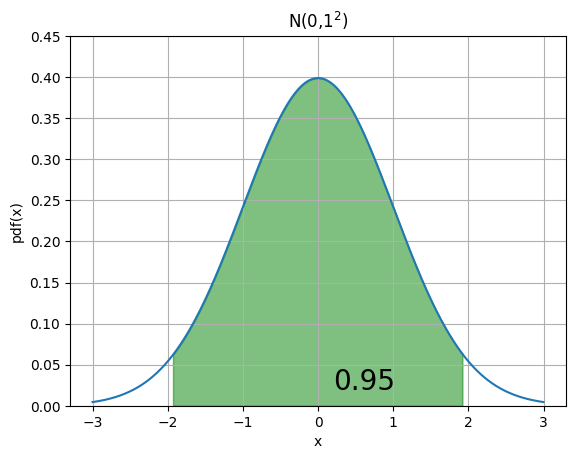

In [91]:
fig, ax = plt.subplots()
# for distribution curve
x= np.arange(-3,3,0.001)
ax.plot(x, norm.pdf(x,loc=0,scale=1))
ax.set_title("N(0,$1^2$)")
ax.set_xlabel('x')
ax.set_ylabel('pdf(x)')
ax.grid(True)
px=np.arange(-1.93,1.93,0.01)
ax.set_ylim(0,0.45)
ax.fill_between(px,norm.pdf(px,loc=0,scale=1),alpha=0.5, color='g')
pro=norm(0, 1).cdf(1.93) - norm(0,1).cdf(-1.93)
ax.text(0.2,0.02,round(pro,2), fontsize=20)
plt.show()

#### 2.2.4 Cálculo de probabilidades:
$\mathbb{P}(0<Z<b)$: Queremos calcular $\mathbb{P}(0<Z<0.43)$, lo cuál puede realizarse de la siguiente manera:
* Tablas de área a la derecha: $\mathbb{P}(0<Z<0.43) = 0.1664$

$\mathbb{P}(-b<Z<b)$: Queremos calcular $\mathbb{P}(-0.16<Z<0.16)$, lo cuál puede realizarse de la siguiente manera:
* Tablas de área a la derecha:  $\mathbb{P}(-0.16<Z<0.16) = \mathbb{P}(-0.16<Z<0)+\mathbb{P} (0<Z<0.16) = \mathbb{P}(0<Z<0.16)+\mathbb{P}(0<Z<0.16) = 2\mathbb{P}(0<Z<0.16) = 2(0.0636) = 0.1272$

$\mathbb{P}(Z<-b)$: Queremos calcular $\mathbb{P}(Z<-1.94)$, lo cuál puede realizarse de la siguiente manera:
* Tablas de área a la derecha: $\mathbb{P}(Z<-1.94) = \mathbb{P}(Z<0)+\mathbb{P}(-1.94<Z<0) = \mathbb{P}(Z<0) + \mathbb{P}(0<Z<1.94) = 0.5 - 0.4738 = 0.0262$

$\mathbb{P}(Z>-b)$: Queremos calcular $(Z>-0.07)$, lo cuál puede realizarse de la siguiente manera:
* Tablas de área a la derecha: $\mathbb{P}(Z>-0.07) = \mathbb{P}(-0.07<Z<0) + \mathbb{P}(Z>0) = \mathbb{P}(0<Z<0.07) + \mathbb{P}(Z>0) = 0.0279 + 0.5 = 0.5279$

### Ejemplos

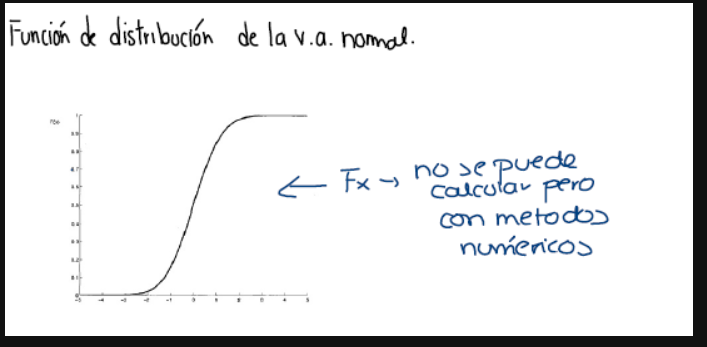

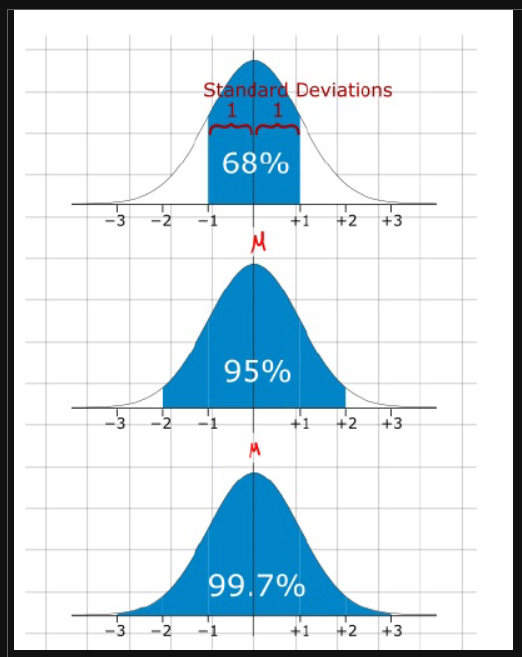

#### 2.2.5 Variable aleatoria Gamma con parámetros $\alpha$ y $\lambda$.

 La distribución gamma se obtiene al considerar el tiempo que transcurre entre cierto número de ocurrencias de eventos que ocurren aleatoriamente en el tiempo

La función gamma $\Gamma:(0,\infty)\to \mathbb{R}$ está definida como
	$$\Gamma(\alpha)=\int_{0}^{\infty}t^{\alpha-1}e^{-t}dt.$$



*Propiedades de la función gamma*.
- $\Gamma(\alpha)<\infty$ para cualquier $\alpha>0$.
- $\Gamma(\alpha+1)=\alpha\Gamma(\alpha)$.
- Si $n\geq 1$ $\Gamma(n)=(n-1)!$
- $\Gamma\left(\frac{1}{2} \right)=\sqrt{\pi}$.



 Si $\alpha$ y $\lambda$ son reales positivos, decimos que una variable aleatoria $X$ tiene distribución gamma con parámetros $\alpha$ y $\lambda$ si tiene por función de densidad:
	$$\displaystyle f_{X}(x)=\begin{cases}
	\displaystyle \frac{\lambda^{\alpha}x^{\alpha-1}e^{-\lambda x} }{\Gamma(\alpha)} & x>0\\
	0 & \text{en otro caso}
	\end{cases}$$
En esta caso, escribimos la información anterior como $X\sim \Gamma(\alpha,\lambda) $


Ejemplo 1. Una computadora cuántica cuenta con un tipo de aparato de medición, el cual tiene un tiempo de vida que se distribuye exponencialmente, de tal manera que su tiempo promedio de vida es de  $1000$ horas. Si se utilizan $10$ de estos aparatos en forma consecutiva, uno de ellos después de que el anterior ya no funciona. ¿Cuál es la probabilidad de que alguno de los aparatos estará funcionando después de $10,000$ horas?


**Solución.**
Sea $X$ el tiempo total de vida de los $5$ aparatos, usados, como se indica, uno después del otro. Entonces $X\sim \Gamma(10, 0.001)$. Así,
$$\mathbb{P}(X>10000)=\int_{10000}^{\infty}\frac{(0.001)^{10}}{9!}x^{9}e^{-0.001x}dx=0.4579.$$

Ejemplo 2.  Consideremos un call center donde los tiempos entre llamadas son independientes y se distribuyen exponencialmente con una media de 3 minutos. Supongamos que queremos encontrar la probabilidad de que transcurran más de 30 minutos antes de recibir 10 llamadas.


**Solución.**
Sea $X$ el tiempo total para recibir $10$ llamadas. Dado que el tiempo medio entre llamadas es de $3$ minutos. Entonces $X \sim \Gamma(10, \frac{1}{3})$. Así
$$P(X > 30) = \int_{30}^{\infty} \frac{\left(\frac{1}{3}\right)^{10} x^{9} e^{-\frac{x}{3}}}{9!} \, dx = 0.45793.$$

**Nota.** Si $X\sim N(0,1)$, entonces $X^{2}\sim \Gamma\left(\frac{1}{2}, \frac{1}{2} \right)$.
En efecto, Para $z>0$, se tiene:
	$$F_{X^{2}}(z)=\mathbb{P}(X^2\leq z)=\mathbb{P}(-\sqrt{z}\leq X\leq \sqrt{z})=F_{X}(\sqrt{z})-F_{X}(-\sqrt{z}).$$
Por lo tanto,
$$f_{X^2}(z)=\frac{d F_{X^{2}}(z)}{dz}=\frac{1}{2\sqrt{z}}f_{X}(\sqrt{z})+\frac{1}{2\sqrt{z}}f_{X}(-\sqrt{z})=\frac{1}{\sqrt{z}}f_{X}(z).$$
Ahora,
$$f_{X}(\sqrt{z})=\frac{1}{\sqrt{2\pi}}e^{-\frac{1}{2}z}.$$


### Esperanza y Varianza

La esperanza, $\text{E}[X]$ para una variable aleatoria $X\sim Γ(\alpha, \lambda)$ es:

$$
\mathbb{E}(X) = \frac{\alpha}{\lambda}
$$
y su varianza es:
$$
\text{Var}(X) = \frac{\alpha}{\lambda^2}
$$



La distribución gamma es esencial en varios campos por su capacidad para modelar tiempos de espera y eventos con tasas constantes. Sus aplicaciones incluyen:

  * $\textbf{Teoría de colas y procesos estocásticos:}$ Modela el tiempo de espera hasta el k-ésimo evento.
  * $\textbf{Confiabilidad y análisis de supervivencia:}$ Utilizada para tiempos de fallo y eventos críticos en medicina.
  * $\textbf{Hidrología y meteorología:}$ Aplica en la modelación de precipitaciones acumuladas y tamaños de gotas.
  * $\textbf{Procesamiento de imágenes y señales:}$ En el ajuste de modelos a datos de intensidades.
  * $\textbf{Finanzas:}$ Para rendimientos de activos que no siguen distribuciones normales.
  * $\textbf{Biología y ecología:}$ Para tasas de crecimiento y tiempos entre eventos biológicos.
  * $\textbf{Física:}$ Describe tiempos de decaimiento y distribuciones de energía.


### Ejemplo 

- Si $\alpha = 1$, $\lambda > 0 \Rightarrow$ v.a. exponencial.

- Si $\lambda = \frac{1}{2}$, $\alpha = \frac{k}{2}$, $k \in \mathbb{Z}^{+} \Rightarrow$ ji-cuadrada.

- Si $\lambda > 1$ y $\alpha > 1 \Rightarrow$ Erlang $\Rightarrow$ aplicaciones.


Sea $X \sim \mathcal{N}(0,1)$. Demostrar que $ X^2 $ tiene una distribución gamma.

**Solución:** Para $z \geq 0$, se tiene que:

$$
\begin{align*}
F_{X^2}(z) &= P(X^2 \leq z) = P(-\sqrt{z} \leq X \leq \sqrt{z}) \\
&= F_X(\sqrt{z}) - F_X(-\sqrt{z}) \\
\end{align*}
$$
Derivando, obtenemos la función de densidad:

$$ f_{X^2}(z) = \frac{d}{dz} F_{X^2}(z) = \frac{1}{2\sqrt{z}} f_X(\sqrt{z}) + \frac{1}{2\sqrt{z}} f_X(-\sqrt{z}) $$

Como la densidad de $X$ es simétrica, se tiene que 

$$ f_{X^2}(z) = \frac{1}{\sqrt{2\pi}} e^{-z/2} \frac{1}{2\sqrt{z}} $$

$$ \frac{(1/2)^{1/2} z^{-1/2} e^{-z/2}}{\Gamma(1/2)} $$

$$ \sim Gamma\left(\frac{1}{2}, \frac{1}{2}\right) $$

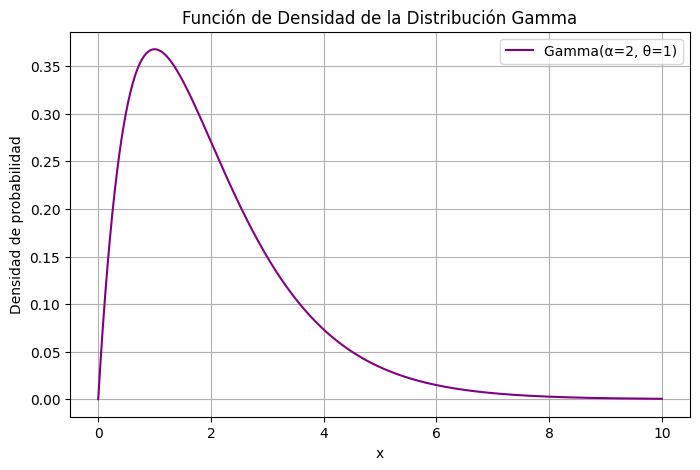

In [99]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gamma

# Parámetros de la distribución Gamma
shape_param = 2  # Parámetro de forma (k o α)
scale_param = 1  # Parámetro de escala (θ)

# Generar valores de x
x = np.linspace(0, 10, 1000)

# Calcular la PDF de la distribución Gamma
gamma_pdf = gamma.pdf(x, a=shape_param, scale=scale_param)

# Graficar la PDF de la distribución Gamma
plt.figure(figsize=(8, 5))
plt.plot(x, gamma_pdf, label=f'Gamma(α={shape_param}, θ={scale_param})', color='purple')
plt.xlabel('x')
plt.ylabel('Densidad de probabilidad')
plt.title('Función de Densidad de la Distribución Gamma')
plt.grid(True)
plt.legend()
plt.show()

- Si $\alpha = 1$, $\lambda > 0 \Rightarrow$ v.a. exponencial.

- Si $\lambda = \frac{1}{2}$, $\alpha = \frac{k}{2}$, $k \in \mathbb{Z}^{+} \Rightarrow$ ji-cuadrada.

- Si $\lambda > 1$ y $\alpha > 1 \Rightarrow$ Erlang $\Rightarrow$ aplicaciones.


Sea $X \sim \mathcal{N}(0,1)$. Demostrar que $ X^2 $ tiene una distribución gamma.

**Solución:** Para $z \geq 0$, se tiene que:

$$
\begin{align*}
F_{X^2}(z) &= P(X^2 \leq z) = P(-\sqrt{z} \leq X \leq \sqrt{z}) \\
&= F_X(\sqrt{z}) - F_X(-\sqrt{z}) \\
\end{align*}
$$
Derivando, obtenemos la función de densidad:

$$ f_{X^2}(z) = \frac{d}{dz} F_{X^2}(z) = \frac{1}{2\sqrt{z}} f_X(\sqrt{z}) + \frac{1}{2\sqrt{z}} f_X(-\sqrt{z}) $$

Como la densidad de $X$ es simétrica, se tiene que 

$$ f_{X^2}(z) = \frac{1}{\sqrt{2\pi}} e^{-z/2} \frac{1}{2\sqrt{z}} = \frac{(1/2)^{1/2} z^{-1/2} e^{-z/2}}{\Gamma(1/2)}  \sim Gamma\left(\frac{1}{2}, \frac{1}{2}\right) $$

#### 2.2.6 Variable aleatoria Beta con parámetros $\alpha$ y $\beta$.


La distribución beta es una familia de distribuciones de probabilidad continua definida en el intervalo [0, 1]. Es particularmente útil para modelar variables que representan proporciones y porcentajes.

La función beta, $B(\alpha, \beta)$, se define como:

$$
B(\alpha, \beta) = \int_0^1 t^{\alpha-1}(1-t)^{\beta-1} dt = \frac{\Gamma(\alpha) \Gamma(\beta)}{\Gamma(\alpha + \beta)}
$$

La función de densidad de probabilidad de la distribución beta se expresa como:

$$
f_X(x) = \frac{x^{\alpha-1}(1-x)^{\beta-1}}{B(\alpha, \beta)},
$$
con $x\in (0,1)$.

**Notación.** $X\sim \text{Beta}(\alpha, \beta)$.



### Esperanza y Varianza
Si $X\sim \text{Beta}(\alpha, \beta)$, entonces
  $$\mathbb{E}[X] = \frac{\alpha}{\alpha + \beta}$$
y
  $$\text{Var}(X) = \frac{\alpha \beta}{(\alpha + \beta)^2 (\alpha + \beta + 1)}.$$





**Ejemplo.** Supongamos que un análisis sugiere que una nueva inversión tiene una alta probabilidad de éxito. Usando una distribución beta con $\alpha = 5$ y $\beta = 1$, entonces:

$$
f_{X}(x) = 5x^4, \quad \mathbb{E}[X] = \frac{5}{6}, \quad \text{Var}(X) = \frac{5}{252}
$$


**Aplicaciones en la Vida Real**

La distribución beta se utiliza en una variedad de campos, incluyendo:
- Finanzas: para modelar la variabilidad en tasas de retorno de inversiones.
- Mercadotecnia: para analizar proporciones de respuesta de consumidores.
- Ciencias de la salud: en la evaluación de la efectividad de tratamientos médicos.
- Ecología: para estimar proporciones en estudios de biodiversidad.

## 3.1 Simulación de variables

### 3.1.1 Generación y uso de variables aleatorias

Daremos recopilación de métodos para generar variables aleatorias utilizados en simulación computacional. Se abordan distribuciones uniformes, exponenciales, normales, binomiales y Poisson, entre otras, así como técnicas como la transformada inversa y el método del rechazo.

Ejemplos comunes en simulación:
- Tiempo entre llegada de cada persona  
- Número de personas por minuto  
- Número de artículos por persona  
- Cantidad de dinero ganado cada hora  
- Tiempo de atención por cliente  
- Número de veces que la cajera solicita ayuda durante la jornada  
- Cantidad de gente que está formada  
- Número de personas que pagan con tarjeta

### 3.1.2 Métodos de generación de números aleatorios rectangulares

La generación de variables aleatorias con esta distribución es importante porque las variables que tengan una distribución diferente, tendrán que usar a ésta como base.

- Cada posible resultado entre $a$ y $b$ tiene la misma probabilidad $1/n$.

Las variables generadas deben cumplir con:
- Los valores generados deben ser independientes y estar idénticamente distribuidos
- La secuencia generada debe ser lo más larga posible y ser reproducibles
- Debe permitir generar múltiples secuencias
- Que usen poca memoria

Históricamente se han usado cuatro tipos de métodos para generar sucesiones de números rectangulares:
- Métodos manuales
- Tablas de biblioteca
- Computación analógica
- Computación digital

#### 3.1.3 Generación pseudoaleatoria

La generación de los números aleatorios rectangulares debe realizarse a través de relaciones matemáticas de recurrencia. Por esta razón se consideran **pseudoaleatorios**, ya que el proceso para generarlos es determinístico.

Hay dos métodos que son los más utilizados para la generación. Ambos se basan en la siguiente definición:

**Definición.** Dos enteros $a$ y $b$ son congruentes módulo $m$ si su diferencia es un múltiplo entero de $m$ y se expresa como
$$𝑎 \equiv 𝑏 ( \text{𝑚o𝑑 } 𝑚)$$
Como consecuencia:
- $(a-b)$ es divisible entre $m$
- $a$ y $b$ dan el mismo residuo al ser divididos entre $m$

#### Método congruencial multiplicativo

Generar una secuencia de números pseudoaleatorios uniformes en el intervalo (0, 1) usando la siguiente fórmula recursiva:

$$n_{i+1} = a n_i \mod m$$
- $m$ debe ser tan grande como sea posible, dependiendo de los bits por palabra que maneje la computadora, descontando el bit del signo ($b$). Por lo tanto: $m = 2^b$
- $a$ debe satisfacer que $a \approx 2^{(b+1)/2}$ y que $a \equiv \pm 3 \mod 8$. La segunda expresión equivale a $( a-(\pm3 ) )$ es múltiplo de $8$.
- $n_0$: entero positivo impar menor a $m$
- El periodo será de longitud: $m/4$

### Ejemplo

In [104]:
# n0 : valor inicial o semilla
# a : multiplicador
# m : modulo (2^b)
# n : el número de numeros que quiero generar

def multiplicativo(n0,a,m,n):
    secuencia = []
    ni = n0 # iniciar con una semilla
    for _ in range(n):
        ni = (a * ni) % m # calculo el sig numero utilizando la formula recurrente
        secuencia.append(ni/m) # normaliza entre 0 y 1
    return secuencia

In [105]:
m = 2**31
a = 65539 # a ≡  +-3 mod 8
n0 = 12345
n=10

secuencia_mult = multiplicativo(n0,a,m,n)
print(secuencia_mult)

[0.37675674771890044, 0.2604887490160763, 0.17212176462635398, 0.6883318466134369, 0.5808951980434358, 0.29038456873968244, 0.5142506300471723, 0.4720426616258919, 0.20400029933080077, 0.9756178413517773]


In [108]:
# Generamos ambas secuencias
secuencia_mult = multiplicativo(n0,a,m,n)
secuencia_numpy = np.random.uniform(0,1,n)

# figura con Plotly
fig = go.Figure()

# Añadir los histogramas
fig.add_trace(go.Histogram(
    x=secuencia_mult,
    nbinsx = 40,
    opacity = 0.6,
    name = 'Método multiplicativo',
    marker_color='red'
))

fig.add_trace(go.Histogram(
    x=secuencia_numpy,
    nbinsx = 40,
    opacity = 0.6,
    name = 'Numpy random uniform',
    marker_color='blue'
))

fig.update_layout(
    barmode='overlay', #superpone los histogramas
    title = 'Compararación: Método multiplicativo -vs- Numpy',
    xaxis_title='valor generado',
    yaxis_title='Frecuencia',
    legend_title='Método',
    bargap=0.05
)

fig.show()

#### Método congruencial mixto

Este método genera números pseudoaleatorios con la fórmula: 
$$n_{i+1} = (a n_i + c) \mod m$$

**Obs.** Se le llama “mixto” porque incluye una constante adicional $c$ (a diferencia del método multiplicativo).

- $m = 2^b$
- $a \approx 2^{(b-1)/2}$, $a \equiv 1 \mod 4$
- $c$, $n_0$: enteros positivos impares $< m$
- Periodo: $m$

### Ejemplo

In [110]:
# n0 : valor inicial o semilla
# a : multiplicador
# c : deber ser impar
# m : modulo (2^b)
# n : el número de numeros que quiero generar

def mixto(n0,a,c,m,n):
    secuencia = []
    ni = n0 # iniciar con una semilla
    for _ in range(n):
        ni = (a * ni + c) % m # calculo el sig numero utilizando la formula recurrente
        secuencia.append(ni/m) # normaliza entre 0 y 1
    return secuencia

In [111]:
m = 2**31
a = 1103515245 # a cong 1 mod----
c = 12345
n0 = 42
n= 10

secuencia_mixto = mixto(n0,a,c,m,n)
print(secuencia_mixto)

[0.5823075897060335, 0.5198187492787838, 0.46597642498090863, 0.7770372582599521, 0.42286502895876765, 0.03337232954800129, 0.41738913068547845, 0.8087285170331597, 0.6123396842740476, 0.7149040475487709]


In [112]:
# Generamos ambas secuencias
secuencia_mixto = mixto(n0,a,c,m,n)
secuencia_numpy = np.random.uniform(0,1,n)

# figura con Plotly
fig = go.Figure()

# Añadir los histogramas
fig.add_trace(go.Histogram(
    x=secuencia_mixto,
    nbinsx = 40,
    opacity = 0.6,
    name = 'Método mixto',
    marker_color='red'
))

fig.add_trace(go.Histogram(
    x=secuencia_numpy,
    nbinsx = 40,
    opacity = 0.6,
    name = 'Numpy random uniform',
    marker_color='blue'
))

fig.update_layout(
    barmode='overlay', #superpone los histogramas
    title = 'Compararación: Método mixto -vs- Numpy',
    xaxis_title='valor generado',
    yaxis_title='Frecuencia',
    legend_title='Método',
    bargap=0.05
)

fig.show()

| **Método**     | **Fórmula**                            | **Ventajas**                                          | **Riesgos / Limitaciones**                                |
|----------------|----------------------------------------|-------------------------------------------------------|------------------------------------------------------------|
| Multiplicativo | \( n_{i+1} = a n_i \mod m \)           | Rápido, menos memoria                                 | Menor aleatoriedad, requiere \( a, m, n_0 \) bien elegidos |
| Mixto          | \( n_{i+1} = (a n_i + c) \mod m \)     | Mejor distribución, periodo completo posible          | Más complejo, pero más robusto                             |
| NumPy (`uniform`) | Motor moderno y validado           | Alta calidad, probado, rápido                         | Caja negra, sin control del generador interno              |


In [114]:
n = 1000

# Generar secuencia usando random.random()
secuencia_random = [random.random() for _ in range(n)]

# Generar secuencia usando numpy
secuencia_numpy = np.random.uniform(0, 1, n)

# Graficar histogramas
fig = go.Figure()

fig.add_trace(go.Histogram(
    x=secuencia_random,
    nbinsx=40,
    opacity=0.6,
    name='random.random()',
    marker_color='crimson'
))

fig.add_trace(go.Histogram(
    x=secuencia_numpy,
    nbinsx=40,
    opacity=0.6,
    name='numpy.random.uniform',
    marker_color='royalblue'
))

fig.update_layout(
    barmode='overlay',
    title='Comparación: random.random() vs numpy.random.uniform',
    xaxis_title='Valor generado',
    yaxis_title='Frecuencia',
    legend_title='Método',
    bargap=0.05
)

fig.show()

## 3.2.1 Metodos de generación de numeros aleatorios no rectangulares

#### 3.2.2 Método de la transformada inversa

El método utiliza la función de distribución $F(x)$ de la distribución que se va a simular 
$$F(x) = \int_{-\infty}^{x} f(t)\,dt$$

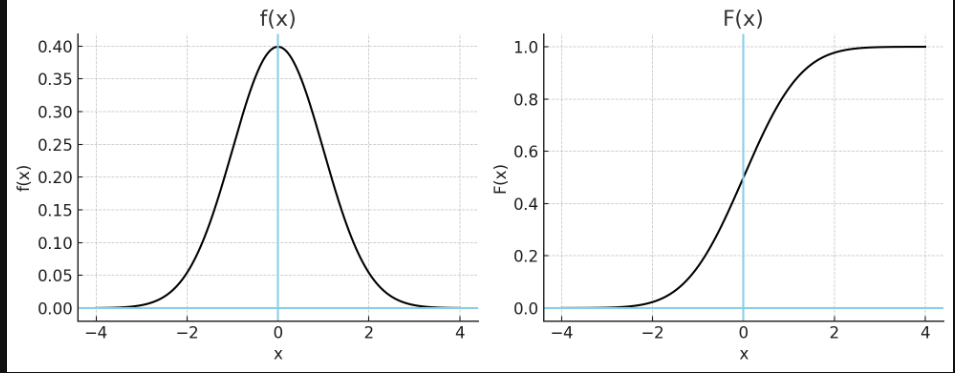

Como se sabe, los valores de $F(x)$ están en el intervalo $(0,1)$ al igual que los números rectangulares $U$. 

El método genera un $U$ y trata de determinar el valor de la variable aleatoria para la cual $F(x)$ sea igual a $U$.

Si $U \in (0,1)$:
$$ F(x) = U \quad \Rightarrow \quad x = F^{-1}(U)$$

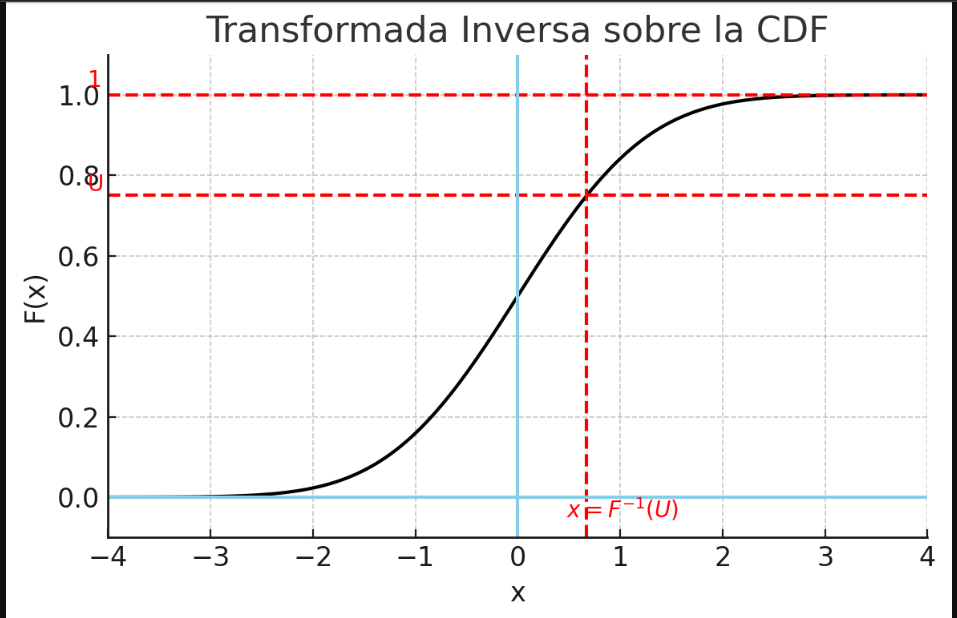

$\mathbf{Teorema}.$ Sea $X$ una variable aleatoria real. Supongamos que su función de distribución $F$ es estrictamente creciente (por lo que $F$ es una biyección de $\mathbb{R}$ sobre $(0,1)$ y podemos denotar por $F^{-1}$ a su inversa). Sea $U\sim \text{unif}[0,1]$. Entonces $F^{-1}(U)$ tiene la misma ley que $X$.

Si $F$ no es estrictamente creciente, hemos visto que el teorema precedente sigue siendo válido bajo la condición de definir 
$$F^{-1}(u)=\inf\{ x\in \mathbb{R} : F(x)\geq u\},$$
la inversa generalizada de $F$.

### Ejemplos

In [119]:
def bernoulli(p):
    u = random.random() # U -> Unif(0,1)
    return 1 if u <= p else 0

In [120]:
# Simulamos n valores con p de éxito
p = 0.5
simulaciones = [bernoulli(p) for _ in range(100)]
print(simulaciones)

[0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0]


In [121]:
sum(simulaciones)

45

### 3.3.1 Distribución exponencial

sea $\theta,\lambda>0$, entonces a través del teorema se puede generar una v.a. exponencial.

Sea $U \sim Unif[0,1]$, entonces si $X\sim Exp(\lambda)$, entonces

$$f_{X}(x) = \lambda e^{-\lambda x}$$ 
y que 
$$ F_X(x) = 1-e^{-\lambda x} $$

Sabemos que $1-e^{-\lambda x} = U$, entonces $1-U = e^{-\lambda x}$, y tomando logaritmo, se tiene que 
$ \ln(1-U) = -\lambda x$ y como $U$ es uniforme entonces $U \sim 1-U$, por lo que depejando a $x$, se tiene que 
$$ X = -\frac{\ln(U)}{\lambda} \sim Exp(\lambda) $$

### 3.4.1 Distribución Uniforme Continua

$$f(x) = \frac{1}{b-a}, \quad a \leq x \leq b$$
$$F(x) = \frac{x-a}{b-a} = U \Rightarrow x = a + (b-a)U$$

### Ejemplo

In [124]:
# Semilla
np.random.seed(123)

# Parámetro de la exponencial
lambd = 4
n = 10000

# Simulación usando transformada inversa
uniformes = np.random.random(n)
exponenciales = -np.log(uniformes) / lambd

# Curva teórica
x_vals = np.linspace(0, exponenciales.max(), 300)
y_vals = lambd * np.exp(-lambd * x_vals)

# Gráfico
fig = go.Figure()

fig.add_trace(go.Histogram(
    x=exponenciales,
    nbinsx=40,
    histnorm='probability density',
    marker_color='skyblue',
    name='Simulación'
))

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    name='Densidad teórica',
    line=dict(color='darkblue')
))

fig.update_layout(
    title='Distribución Exponencial simulada vs teórica (λ = 1)',
    xaxis_title='x',
    yaxis_title='Densidad',
    bargap=0.05
)

fig.show()

In [126]:
# Parámetros de la uniforme
a, b = 2, 5
n = 10000

# Simulación por transformación lineal
uniformes = np.random.random(n)
uniforme_continua = a + (b - a) * uniformes

# Densidad teórica (constante)
x_vals = np.linspace(a, b, 300)
y_vals = np.ones_like(x_vals) * (1 / (b - a))

# Gráfico
fig = go.Figure()

fig.add_trace(go.Histogram(
    x=uniforme_continua,
    nbinsx=40,
    histnorm='probability density',
    marker_color='orange',
    name='Simulación'
))

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    name='Densidad teórica',
    line=dict(color='red')
))

fig.update_layout(
    title='Distribución Uniforme Continua simulada vs teórica [2, 5]',
    xaxis_title='x',
    yaxis_title='Densidad',
    bargap=0.05
)

fig.show()

$\mathbf{Ejemplo}$ (Variable aleatoria Cauchy) Simulemos la variable aleatoria de Cauchy de parámetro $1$ que tiene por función de densidad 
$$\frac{1}{\pi}\frac{1}{1+x^{2}}.$$

### Ejercicio 

- Corroborar que la función así definida es una función de densidad de probabilidad
- Encontrar F_X
- Crear una gráfica en Python que muestre su forma
- Generar v.a. Cauchy a partir de una uniforme

Por el teorema anterior, para $u\in (0,1)$
$$u=\frac{1}{\pi}\arctan(x)+\frac{1}{2} \qquad \text{si y sólo si} \qquad x=\tan\left({\pi}\left(u-\frac{1}{2} \right) \right).$$

### 3.4.2 Variable aleatoria Cauchy

$ (Variable aleatoria Cauchy) Simulemos la variable aleatoria de Cauchy de parámetro $1$ que tiene por función de densidad 
$$\frac{1}{\pi}\frac{1}{1+x^{2}}.$$

### Ejercicio
- Corroborar que la función así definida es una función de densidad de probabilidad.

    \begin{align*}
        \int_{-\infty}^{\infty}\frac{1}{\pi}\frac{1}{1+x^2}&= \frac{1}{\pi}\left(\arctan(\infty)-\arctan(-\infty)\right)\\
        &=\frac{1}{\pi}\left(\frac{\pi}{2}-(-\frac{\pi}{2}) \right)\\
        &=1

    \end{align*}

- Encontrar F_X

    \begin{align*}
    F_X(x)&=\int_{-\infty}^{x}\frac{1}{\pi}\frac{1}{1+u^2}du\\
    &=\frac{1}{\pi}\left(\arctan(x)-\arctan(-\infty)\right)\\
    &=\frac{1}{\pi}\left(\arctan(x)+\frac{\pi}{2}\right)\\
    &=\frac{1}{\pi}\arctan(x)+\frac{1}{2}
  \end{align*}

In [134]:

x_vals = np.linspace(-50,100,500)
y_vals = arctan(x_vals)/pi + 0.5

# Gráfico
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    name='Densidad teórica',
    line=dict(color='red')
))

fig.show()

## 4.1 FGM (Función Generadora de Momentos)

La Función Generadora de Momentos de una variable aleatoria 𝑋, denotada como 
𝑀𝑋(𝑡), es una función definida como:
    $$ M_X(t) = \mathbb{E}\left[e^{tX}\right] $$ 
siempre que la esperanza exista para valores de 𝑡 en algún intervalo abierto que contenga al cero. Es decir, existe un 𝛿 > 0 tal que 𝑀𝑋(𝑡)<∞M X(t)<∞ para todo 𝑡∈(−𝛿,𝛿).

Propiedades Clave
1.	Generación de momentos:
La n-ésima derivada de MX(t)) evaluada en t=0 da el n-ésimo momento de X alrededor del origen:
$$ M_X^{(n)}(0) = \mathbb{E}\left[X^n\right] $$

Unicidad:
Si dos variables aleatorias tienen la misma FGM en un entorno del cero, entonces tienen la misma distribución.


Linealidad y escalamiento:
Si $ a,b  \in \mathbb{R} $ , entonces la FGM de Y= aX+b = es:
$$ M_Y(t) = e^{bt} \cdot M_X(at) $$


Independencia:
Si X y Y son variables aleatorias independientes, entonces:
$$ M_{X+Y}(t) = M_X(t) \cdot M_Y(t) $$

Aplicaciones
Cálculo de momentos (media, varianza, etc.)

Caracterización de distribuciones

Demostraciones de convergencia en distribución (usando el teorema de continuidad de Lévy)

Análisis de sumas de variables aleatorias independientes

Relación con otras funciones generadoras
La FGM está relacionada con la función característica 𝜙𝑋(𝑡)=𝐸[𝑒𝑖𝑡𝑋], que siempre existe, incluso cuando la FGM no.

También está relacionada con la función generadora de probabilidades en el caso de variables discretas no negativas.

### Ejemplo

Definir la FGM analíticamente.

Simular datos de una distribución exponencial.

Calcular 𝑀𝑋(𝑡) empíricamente para algunos valores de 𝑡

Comparar el valor teórico con el valor empírico.

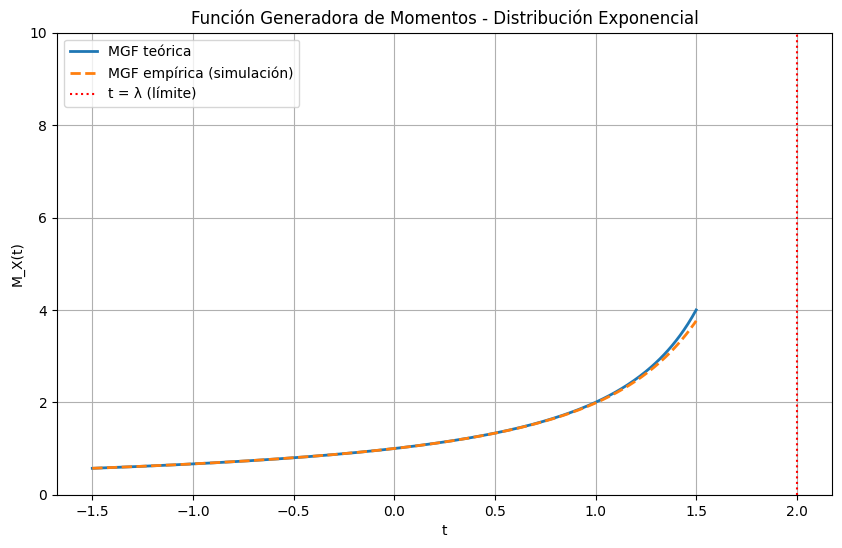

In [137]:
import numpy as np
import matplotlib.pyplot as plt

# Parámetro de la distribución exponencial
lambd = 2.0

# Valores de t para evaluar M_X(t)
t_vals = np.linspace(-1.5, 1.5, 300)

# FGM teórica de la exponencial
def mgf_theoretical(t, lambd):
    return lambd / (lambd - t)

# Simulación de datos
np.random.seed(42)
sample_size = 100000
X = np.random.exponential(scale=1/lambd, size=sample_size)

# FGM empírica: E[e^{tX}]
def mgf_empirical(t_vals, X):
    return np.array([np.mean(np.exp(t * X)) for t in t_vals])

# Calcular ambas versiones
mgf_emp = mgf_empirical(t_vals, X)
mgf_th = mgf_theoretical(t_vals, lambd)

# Graficar
plt.figure(figsize=(10, 6))
plt.plot(t_vals, mgf_th, label='MGF teórica', linewidth=2)
plt.plot(t_vals, mgf_emp, '--', label='MGF empírica (simulación)', linewidth=2)
plt.axvline(lambd, color='red', linestyle=':', label='t = λ (límite)')
plt.ylim(0, 10)
plt.title("Función Generadora de Momentos - Distribución Exponencial")
plt.xlabel("t")
plt.ylabel("M_X(t)")
plt.legend()
plt.grid(True)
plt.show()
